### Disclaimer

<b>I herewith state that I have not received any unauthorized assistance in solving this exam.</b>

--- Mohammad Tanzil Alam and <u>Sign: Md. Tanzil Alam</u>.

### Executive summary [20 points]

The following data analysis summary is the result of a project showing the economic and demographic characteristic of various US universities. The project mainly revolve around out_of_state fee and make_world_better_percent.<br><br>

The purpose of this analysis is to predict the problem which might encounter to estimate the out_of_state tuition fee for the next year. As the out_of_state tuition is main concern of whether it is related to different ethnicity, making world a better place, room and board or total enrollment.<br><br>

Two datas were collected namely university and tuition income for this project. I worked on specific list of Universities  which were in states New Mexico,Utah, Montana, Kentucky, South Carolina, Alabama, Idaho, West Virginia, Arkansas and Mississipi. Further going down the road when I was asked in Correlation to merge the dataset. I found that only 75% of the universites of "University" dataset was getting matched with "tuition income" dataset, for which then I have performed different data cleaning, mathematical and statistical method to find the median, mode, to make my tuition income data more precise so that it could get merge.<br><br>

After creating a new dataset that is "dfmid", I found a better correlation between out_of_state tuition and other features of the newly created dataset in comaprision to my orignal dataset. After performing merge between two dataset that is university an tuition income the correlation grows more better with the target feature. In the data cleaning process the dataset did not show much missing values . However, these missing datas were sucessfully handled with "Multiple Imputation"
Data cleaning method. Then moving forward by using standardization featuring scale  a train and test dataset with the ratio of 70% & 30% respectively was created. When I  finally landed at Regression I Analyse that the dataset I found that no data available for the state "Montana"; which was making an obstruction in different techniques of Regression like Liner Regression, etc. Hence this issue was solved by using a drop method with the state Montana. In Regression Evaluation method, Random Forest Regression shows best accuracy. Lastly landing into classification where it was said to create a confusion matrix and analyse between SVM, k-NN and Random Forest. The Random Forest model prevails and shows an accuracy approximation of 88.46%.<br><br>

It can be concluded that to find a profit or estimate of out_of_state tuition fee we should consider mainly on students from different ethnicity rather than from native place. Plus, the more students we will acquire, the more will be the research by the university and then the "make_world_better_percent" will actually become better. 

### Problem 1 [3 points]
Load the data provided in universities.csv from the moodle course page. The data is about economic and
demographic characteristics of various US universities.
Load the data from tuition_income.csv from the same page.
Select from the universities dataset data for all universities located in the following states: New Mexico,
Utah, Montana, Kentucky, South Carolina, Alabama, Idaho, West Virginia, Arkansas, Mississipi. Use this
restricted data set as basis for the entire exam (and modify accordingly in the following questions).

In [1]:
import pandas as pd
import plotly.express as px
from scipy import stats
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import scale
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR, SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
pd.set_option('max_columns', None)
import warnings
warnings.filterwarnings('ignore')
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score,roc_curve,auc,plot_confusion_matrix

In [2]:
# Taking University dataset
uni= pd.read_csv("universities.csv")
uni

,Unnamed: 0,name,total_enrollment,state,n_native,n_asian,n_black,n_hispanic,n_pacific,n_nonresident,n_total_minority,n_multiracial,n_unknown,n_white,n_women,state_code,type,degree_length,room_and_board,in_state_tuition,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,stem_percent
0,0,Aaniiih Nakoda College,291,Montana,256,0,0,2,0,0,258,0,0,33,178,MT,Public,2 Year,NaN,2380,2380,2380,2380,NaN,NaN,NaN,NaN
1,1,Abilene Christian University,4427,Texas,18,46,387,582,0,185,1212,179,71,2959,2562,TX,Private,4 Year,10350.0,34850,45200,34850,45200,NaN,NaN,NaN,NaN
2,2,Abraham Baldwin Agricultural College,3458,Georgia,9,36,407,197,1,49,680,30,1,2728,1822,GA,Public,2 Year,8474.0,4128,12602,12550,21024,NaN,NaN,NaN,NaN
3,3,Academy College,127,Minnesota,1,10,14,6,3,0,35,1,12,80,28,MN,For Profit,2 Year,NaN,17661,17661,17661,17661,NaN,NaN,NaN,NaN
4,4,Academy of Art University,15212,California,70,1092,999,1383,75,5173,3931,312,2652,3456,8815,CA,For Profit,4 Year,16648.0,27810,44458,27810,44458,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2154,York Technical College,5061,South Carolina,40,57,1233,267,2,1,2094,495,45,2921,3023,SC,Public,2 Year,NaN,5740,5740,12190,12190,NaN,NaN,NaN,NaN
2155,2155,Young Harris College,1218,Georgia,3,10,75,49,4,89,163,22,34,932,701,GA,Private,4 Year,12372.0,29117,41489,29117,41489,NaN,NaN,NaN,NaN
2156,2156,Youngstown State University,12503,Ohio,30,113,1558,419,9,213,2396,267,439,9455,6693,OH,Public,4 Year,9400.0,8950,18350,14950,24350,NaN,NaN,NaN,NaN
2157,2157,Yuba College,6640,California,79,744,262,2032,25,2,3544,402,248,2846,3971,CA,Public,2 Year,NaN,1400,1400,8420,8420,NaN,NaN,NaN,NaN


In [3]:
# Taking Tuition Income datatset
dftution= pd.read_csv("tuition_income.csv")

### 1. How many universities are in the resulting dataset? [1] 

In [4]:
df = uni
df = df.loc[df['state'].isin(["New Mexico", 
                            "Utah", 
                            "Montana", 
                            "Kentucky", 
                            "South Carolina", 
                            "Alabama", 
                            "Idaho", 
                            "West Virginia", 
                            "Arkansas", 
                            "Mississipi"])]


df = df[df["name"].str.contains('University')]
df

,Unnamed: 0,name,total_enrollment,state,n_native,n_asian,n_black,n_hispanic,n_pacific,n_nonresident,n_total_minority,n_multiracial,n_unknown,n_white,n_women,state_code,type,degree_length,room_and_board,in_state_tuition,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,stem_percent
14,14,Alabama State University,5519,Alabama,8,20,4950,68,3,130,5105,56,76,208,3430,AL,Public,4 Year,5422.0,11068,16490,19396,24818,39800.0,71500.0,61.0,16.0
33,33,Allen University,660,South Carolina,0,1,652,4,0,0,657,0,0,3,371,SC,Private,4 Year,7230.0,13340,20570,13340,20570,NaN,NaN,NaN,NaN
48,48,Amridge University,625,Alabama,0,4,255,5,0,0,264,0,180,181,372,AL,Private,4 Year,NaN,6900,6900,6900,6900,35700.0,65900.0,NaN,0.0
70,70,Arkansas Tech University,12002,Arkansas,121,154,919,728,8,449,2239,309,0,9314,6689,AR,Public,4 Year,7870.0,9068,16938,15848,23718,45000.0,76900.0,54.0,7.0
77,77,Asbury University,1879,Kentucky,4,14,92,40,5,30,254,99,86,1509,1142,KY,Private,4 Year,7160.0,30198,37358,30198,37358,39400.0,70800.0,59.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2075,2075,Western Governors University,57821,Utah,360,2195,5442,4291,288,73,14236,1660,1614,41898,35024,UT,Private,4 Year,NaN,6670,6670,6670,6670,54500.0,91500.0,57.0,9.0
2078,2078,Western Kentucky University,20171,Kentucky,46,210,1938,515,18,1434,3171,444,252,15314,11710,KY,Public,4 Year,8343.0,10602,18945,26496,34839,45500.0,83100.0,49.0,10.0
2083,2083,Western New Mexico University,3557,New Mexico,100,46,145,1442,5,49,1755,17,760,993,2220,NM,Public,4 Year,9136.0,6824,15960,15231,24367,41700.0,76700.0,75.0,4.0
2096,2096,Wheeling Jesuit University,1575,West Virginia,4,19,70,31,2,46,151,25,140,1238,889,WV,Private,4 Year,9900.0,29290,39190,29290,39190,44800.0,83400.0,57.0,5.0


Solution: There in total 99 Universities in the resulting Dataset.

### 2. Graduates of how many universities have an estimated early career pay greater than 50000 dollars per year? [1]

In [5]:
# ECP is estimated early career pay
ECP = df[df['early_career_pay']>50000]
ECP

,Unnamed: 0,name,total_enrollment,state,n_native,n_asian,n_black,n_hispanic,n_pacific,n_nonresident,n_total_minority,n_multiracial,n_unknown,n_white,n_women,state_code,type,degree_length,room_and_board,in_state_tuition,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,stem_percent
89,89,Auburn University,25912,Alabama,183,601,1886,599,0,1427,3269,0,361,20855,12798,AL,Public,4 Year,13332.0,11276,24608,30524,43856,54400.0,104500.0,51.0,31.0
188,188,Boise State University,22227,Idaho,132,436,357,2149,71,816,3842,697,650,16919,12120,ID,Public,4 Year,10692.0,7694,18386,23776,34468,50100.0,86400.0,55.0,14.0
356,356,Clemson University,21857,South Carolina,41,389,1347,593,14,1569,2849,465,563,16876,10160,SC,Public,4 Year,10832.0,14970,25802,36724,47556,57500.0,106700.0,50.0,39.0
820,820,Idaho State University,13429,Idaho,141,179,156,1122,28,1358,1937,311,494,9640,6964,ID,Public,4 Year,7207.0,7420,14627,22940,30147,50800.0,91800.0,64.0,12.0
1093,1093,Medical University of South Carolina,2898,South Carolina,9,170,240,103,1,45,569,46,140,2144,1832,SC,Public,4 Year,NaN,26826,26826,26826,26826,54800.0,92700.0,88.0,6.0
1176,1176,Montana Tech of the University of Montana,2085,Montana,35,20,23,34,0,222,113,1,133,1617,677,MT,Public,4 Year,9656.0,7411,17067,22574,32230,61200.0,112600.0,64.0,61.0
1850,1850,Tuskegee University,3103,Alabama,2,26,2345,32,0,20,2405,0,626,52,1855,AL,Private,4 Year,9650.0,22170,31820,22170,31820,54500.0,93500.0,61.0,30.0
1860,1860,University of Arkansas for Medical Sciences,2890,Arkansas,7,132,260,96,1,66,566,70,91,2167,1882,AR,Public,4 Year,NaN,8197,8197,15973,15973,51700.0,89100.0,84.0,3.0
1887,1887,University of Idaho,11702,Idaho,113,161,142,925,22,714,1739,376,396,8853,5482,ID,Public,4 Year,8880.0,7864,16744,25500,34380,52300.0,97700.0,54.0,22.0
1894,1894,University of Kentucky,29203,Kentucky,55,807,1989,1031,26,1751,4678,770,997,21777,15420,KY,Public,4 Year,12982.0,12245,25227,29099,42081,51700.0,96400.0,48.0,19.0


Solution: 15 Universities Graduates are having an estimated early career pay greater than 50000 dollars
per year?

### 3. How many universities are not public? [1]

In [6]:
# Not public = Private + For Profit
pvt = df[df['type']!= 'Public']
print(pvt.type.value_counts())
pvt

Private       36
For Profit     2
Name: type, dtype: int64


,Unnamed: 0,name,total_enrollment,state,n_native,n_asian,n_black,n_hispanic,n_pacific,n_nonresident,n_total_minority,n_multiracial,n_unknown,n_white,n_women,state_code,type,degree_length,room_and_board,in_state_tuition,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,stem_percent
33,33,Allen University,660,South Carolina,0,1,652,4,0,0,657,0,0,3,371,SC,Private,4 Year,7230.0,13340,20570,13340,20570,NaN,NaN,NaN,NaN
48,48,Amridge University,625,Alabama,0,4,255,5,0,0,264,0,180,181,372,AL,Private,4 Year,NaN,6900,6900,6900,6900,35700.0,65900.0,NaN,0.0
77,77,Asbury University,1879,Kentucky,4,14,92,40,5,30,254,99,86,1509,1142,KY,Private,4 Year,7160.0,30198,37358,30198,37358,39400.0,70800.0,59.0,4.0
133,133,Bellarmine University,3609,Kentucky,9,65,196,101,5,48,473,97,124,2964,2430,KY,Private,4 Year,12250.0,42200,54450,42200,54450,49000.0,90700.0,54.0,11.0
186,186,Bob Jones University,3108,South Carolina,8,73,44,177,12,180,394,80,205,2329,1702,SC,Private,4 Year,6976.0,18150,25126,18150,25126,NaN,NaN,NaN,NaN
202,202,Brescia University,1056,Kentucky,9,3,133,63,2,10,210,0,132,704,771,KY,Private,4 Year,9200.0,22400,31600,22400,31600,44300.0,81200.0,53.0,7.0
208,208,Brigham Young University,30484,Utah,112,593,157,1685,178,1164,3754,1029,358,25208,13680,UT,Private,4 Year,7628.0,5620,13248,5620,13248,NaN,NaN,NaN,NaN
245,245,Campbellsville University,3427,Kentucky,6,17,375,56,4,226,499,41,54,2648,1986,KY,Private,4 Year,8000.0,25400,33400,25400,33400,37600.0,66800.0,50.0,7.0
316,316,Charleston Southern University,3367,South Carolina,18,41,926,108,4,24,1164,67,157,2022,2096,SC,Private,4 Year,10200.0,25500,35700,25500,35700,42800.0,76300.0,65.0,9.0
341,341,Claflin University,1866,South Carolina,20,14,1693,31,0,75,1762,4,0,29,1224,SC,Private,4 Year,9294.0,16622,25916,16622,25916,NaN,NaN,NaN,NaN


Solution: 38 Universities are not public .

### Problem 2: Making sense of your data [15 points]

In [7]:
df.dtypes

Unnamed: 0                     int64
name                          object
total_enrollment               int64
state                         object
n_native                       int64
n_asian                        int64
n_black                        int64
n_hispanic                     int64
n_pacific                      int64
n_nonresident                  int64
n_total_minority               int64
n_multiracial                  int64
n_unknown                      int64
n_white                        int64
n_women                        int64
state_code                    object
type                          object
degree_length                 object
room_and_board               float64
in_state_tuition               int64
in_state_total                 int64
out_of_state_tuition           int64
out_of_state_total             int64
early_career_pay             float64
mid_career_pay               float64
make_world_better_percent    float64
stem_percent                 float64
d

### 1. Take a quick look at the data structure. Describe the dataset in a few sentences. [2]

Most of the columns in our University data are of type "int64". This means that they are 64 bit integers. But type "float64" column is a floating point value which means it contains decimals. Some datatypes are of "object", which means it contain numeric or strings or both vaues.

### 2. Which facts or principles do you need to know about US university system to make a good sense of this dataset? [2]

According to my evaluation, name of the university, state, total enrollment is important as it will give us an idea of the total number of students getting admission each year. Henceforth, the state code, type of university is also informative to know whether the university is public, private or for profit. Walking down the road, degree length gives the duration of the course plus, the private in_state_tuition, out_of_state_tuition and private in_state_total, out_of_state_total accounts for same data, so maybe we can merge it into one column to reduce number of columns. Early career pay, mid career pay gives a solid idea of how much they are going to earn during and after getting a degree. Make_world_better_percent also importantly contribute to the dataset as it gives an idea as how much we are contributing towars world with our knowledge.

### 3. Which things about the data you have at hand you do not know for sure and have to assume? [2]

Some of the data's I have less idea about thier existance are:

n_asian                        
n_black                        
n_hispanic                     
n_pacific  
n_total_minority   
n_multiracial  
n_unknown             
n_white          
room_and_board        
stem_percent                 

### 4. In this project, you will have to predict out-of-state tuition fee. Do students choose university solely based on the cost? Which other factors might be important? [2]

No, student have not selected university only on the basis of cost. If we will compare total_enrollment of row no. 70 and 84, the out_of_state tuition fee of row number 70 is 15848 and total_enrollment = 12002, also out_of_state tuition fee of row number 84 is 12870 and total_enrollment = 3128. As we can see the university in row 70 costs higher and also have higher enrollment of student than university in row number 84, which is cheaper, it can deduce that students are not choosing university on the basis of cost.

Other factors which might be important other than the University are, type of university, early_career_pay and mid_career_pay.

### 5. To whom is this cost variable more important than the other three? Explain. [2]



Other than those three the cost variable are important room_and_board. As we can see that the total cost whether it be in_state_tuition or out_of_state_tuition, the room_and_board are adding up in the total cost of both of these.

### 6. Formulate a reasonable business goal, execution of which would require analysis of out-of-state tuition fee in this dataset. [1]

### 7. Which variable would you have to optimize for this goal? What variables would you have to constrain for it to be reasonable? [1]

The variable which I will optimize will be total_enrollment.  I will put constrain on mid_career_pay.

### 8. Which data manipulations would you have to perform for an analysis or an ML system for this goal? What would you have to predict? Would classification or regression be more suitable, and why? [3]

### Problem 3: EDA and Data preprocessing [10 points]

In [8]:
# Number of time different states occurs in dataset.
print(df.state.value_counts())

Alabama           20
Kentucky          17
Arkansas          16
South Carolina    15
West Virginia     12
New Mexico         9
Idaho              4
Utah               4
Montana            2
Name: state, dtype: int64


In [9]:
# Number of time different states_codes occurs in dataset. 
print(df.state_code.value_counts())

AL    20
KY    17
AR    16
SC    15
WV    12
NM     9
ID     4
UT     4
MT     2
Name: state_code, dtype: int64


In [10]:
# Different types of University
print(df.type.value_counts())

Public        61
Private       36
For Profit     2
Name: type, dtype: int64


In [11]:
# Different length period
print(df.degree_length.value_counts())

4 Year    90
2 Year     9
Name: degree_length, dtype: int64


In [12]:
# Counting all categorical variables in dataset
columns = ['state', 'state_code', 'type', 'degree_length']
for cols in columns:
    samples = df[cols].nunique()
    print("Total number of categories in", cols , " is ", samples)

Total number of categories in state  is  9
Total number of categories in state_code  is  9
Total number of categories in type  is  3
Total number of categories in degree_length  is  2


### 1. Check how many categorical features exist and for each categorical feature see how many samples belong to each category. [2]

There are four categorical features which exist, those are: state, state_code, type and degree.length.

No. of samples belong to each category are:

state = 9;
state_code = 9;
type = 3;
degree.length = 2;

### 2. Visualize the distributions of all features in the data set and summarize your findings. [6]

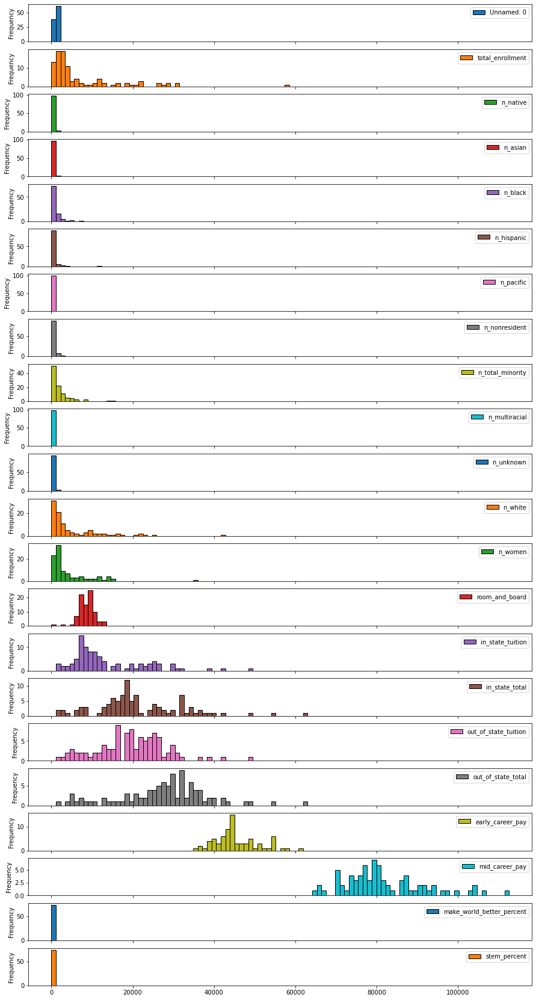

In [13]:
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
df.plot.hist(subplots= True,bins=100,figsize=(15,30),edgecolor='black');

### Summary

Unnamed: We don't see much distriution as it is equal to the Serial number <br><br>
total_enrollment: There we experience a right skewed plot. Which means number of students getting enrolled are as high as 5000, hence declintion is observed until 35000.<br><br>
n_native: Few thousand native students are only enrolled in university <br><br>
n_asian: This also contrubute as same as n_native, concluding that few students from asian countries went to USA for studying. <br><br>
n_black: This shows a minor right skewed graph which means that we will find these category student on a average, <br><br>
n_hispanic: It shows distribution almost equal to what we have seen in n_asian. Contributing only few thousands of students <br><br>
n_pacific: It shows distribution almost equal to what wehave seen in n_asian.  Contributing only few thousands of students<br><br>
n_nonresident: It shows distribution almost equal to what wehave seen in n_asian.  Contributing only few thousands of students<br><br>
n_total_minority: Here we see a right skewed, indicating high frequescy of students coming from minorities. <br><br>
n_multiracial: Multiracial shows excalty same distribution as n_pacific. Contributing few thousands of students. <br><br>
n_unknown: This growth is similar to n_hispanic distribution. <br><br>
n_white: This shows a right skewed showing high number of student in each intervals upto 45000 approx. <br><br>
n_women: This is also a right skewed which show high number during 5000 thousand and then there is a certain drop gofing forward. <br><br>
room_and_board: This histogram shows a rise and then fall of frequency before and after 10000's<br><br>
in_state_tuition: Leading at approx 8000, in state tution shows quite a distribution of mean value in each frequency level.<br><br>
in_state_total: The distribution shows a gradual incease and gradual decreas in the frequency, shooting up again at approx 32000, extending the mean upto 63000 approximate.<br><br>
out_of_state_tuition: Show a little co-relation with in_state_total where the average frequency is below 5.<br><br>
out_of_state_total: This represent a left skewed graph. Extending upto 62000 with highest frequency at 35000.<br><br>
early_career_pay: Shows an average frequency distribution of below 10.<br><br>
mid_career_pay: Shows a right skewed, with frequency of 1.0 approaching to 80000. Starting its mean value at 65000 mean approx and extending above 100000. <br><br>
make_world_better_percent: This also contrubute as same as n_native. <br><br>
stem_percent: This also contrubute as same as n_native

### 3. Split the data set into a training (70%) and a test (30%) set with the help of stratified sampling based on the degree length. Report mean and standard deviation for out_of_state_tuition in train and test data set. [2]

In [14]:
# Splitting data into test and train dataset

from sklearn.model_selection import train_test_split
X = df.loc[:, df.columns != 'out_of_state_tuition']
y = df['out_of_state_tuition']

X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    stratify=df['degree_length'], 
                                                    test_size=0.3)

In [15]:
y_train.describe()

count       69.000000
mean     18721.202899
std       7962.322176
min       1376.000000
25%      13340.000000
50%      18680.000000
75%      23776.000000
max      38750.000000
Name: out_of_state_tuition, dtype: float64

In [16]:
y_test.describe()

count       30.000000
mean     22166.766667
std       9787.517352
min       2360.000000
25%      18729.000000
50%      22970.000000
75%      26610.000000
max      49532.000000
Name: out_of_state_tuition, dtype: float64

### Problem 4: Data Visualization [16 points]

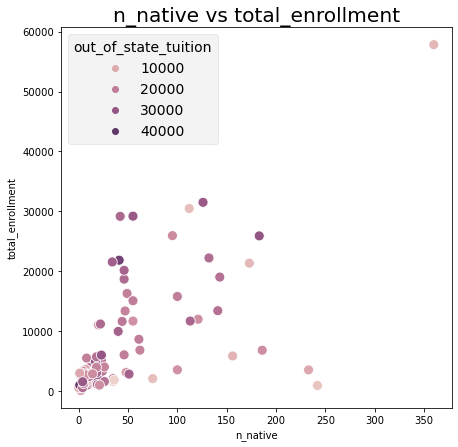

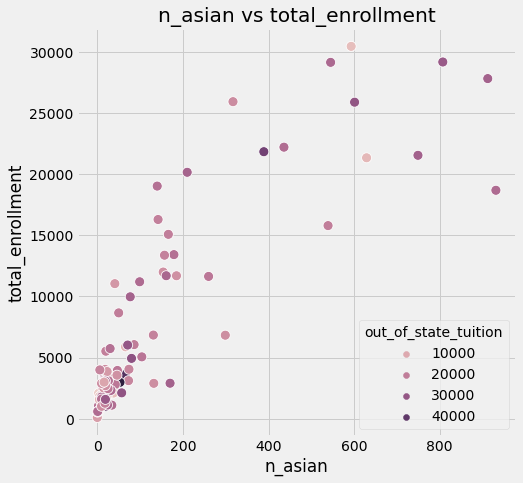

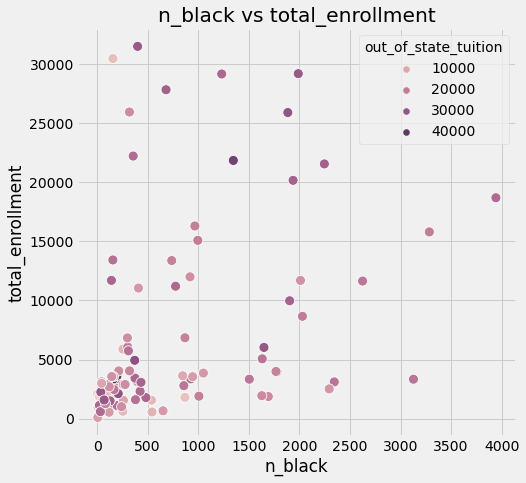

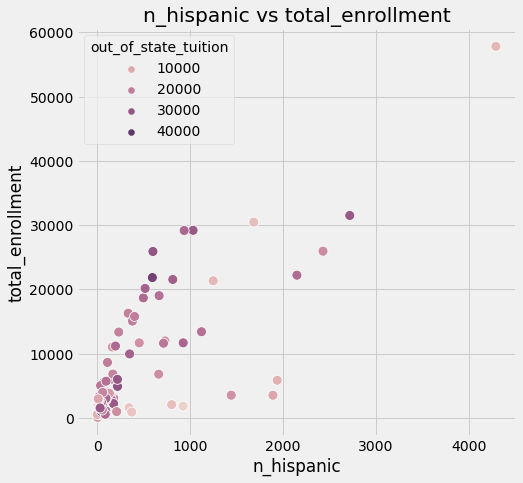

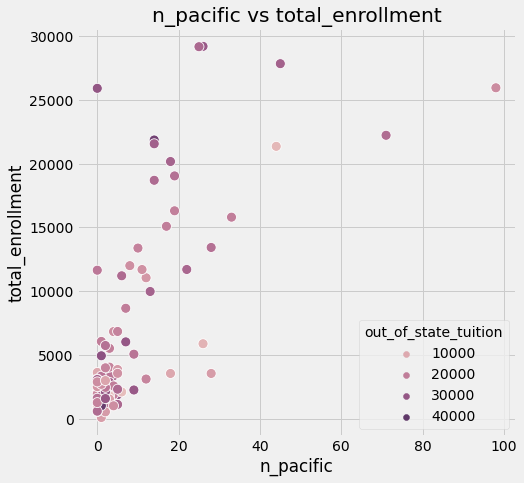

...

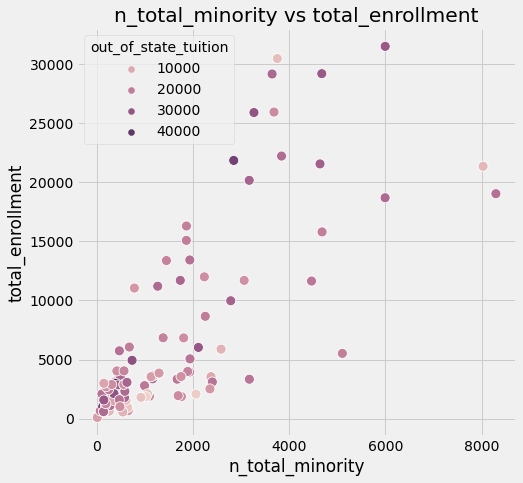

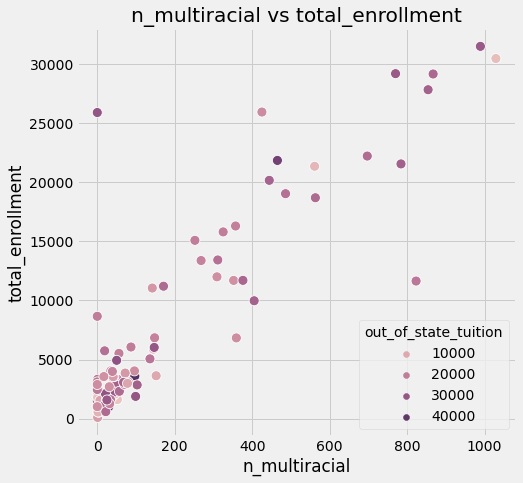

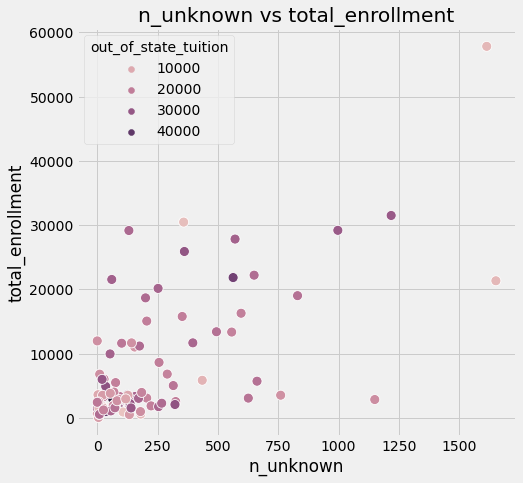

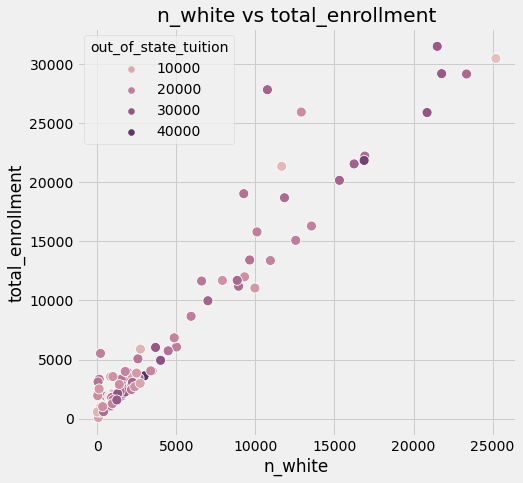

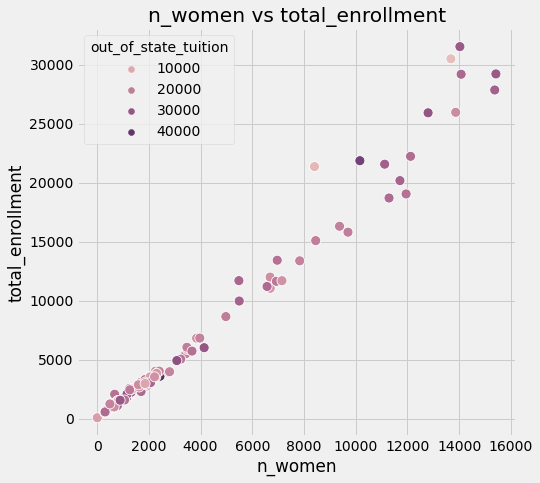

In [17]:
from scipy import stats, optimize, interpolate
columns = ['n_native', 'n_asian', 'n_black',
       'n_hispanic', 'n_pacific', 'n_nonresident', 'n_total_minority',
       'n_multiracial', 'n_unknown', 'n_white', 'n_women']
for col in columns:
    ax = sns.scatterplot(data =df[(np.abs(stats.zscore(df[col])) < 3)] , x=col, y='total_enrollment', hue='out_of_state_tuition', s=100)
    
    plt.style.use('fivethirtyeight')
    plt.title(col +' vs total_enrollment')
    plt.xlabel(col)
    plt.ylabel('total_enrollment')
    plt.legend(title = 'out_of_state_tuition' )
    plt.gcf().set_size_inches(7, 7)
    plt.show()

### 1. Describe what can be seen and interpret it. [5]


The scatterplot between n_native and enrollment shows an association that is positive, linear, and appears to be somewhat strong with a few outliers. We can also find good number of native students with the total enrollment of 32000 and few around 350 native students with enrollment approx 60000. <br><br>

The scatterplot between n_asian and enrollment shows an association that is positive, linear, and appears to be somewhat strong with a medium outliers. We can also find high density of asian students upto total_enrollment of 5000. <br><br>

The scatterplot between n_black and enrollment shows an association that is positive, non-linear, and appears to be somewhat strongly scatters. We can also find high density of black students during first few total enrollment of 5000. But this graph also depicts there are quite a number of students scattered around each interval of total_enrollment.<br><br>

The scatterplot between n_hispanic and enrollment shows an association that is positive, linear, and appears to be somewhat strong with a few outliers. The number of hispanic students are approx 2500 in the total enrollment of 30000 and below, and only few around 4000 with total enrollment of 60000.<br><br>


The scatterplot between n_pacific and enrollment shows an association that is positive, linear, and appears to be somewhat strong with few outliers. Maximum of approx 38 pacific students can be observed for the enrollment upto 30000 and few students with medium out of state tuition are represented in the outliers.<br><br>

The scatterplot between n_resident and enrollment shows an association that is positive, curve, and appears to be somewhat strong with few outliers. A gap can br observed in nonresident students between around 800 to 1600. However, we can also find few hundered students in the total enrollment of around 60000.<br><br>

The scatterplot between n_minority and enrollment shows an association that is positive, non-linear, and appears to be somewhat strong with a medium outliers. Maximum number of students are getting chance in university with high enrollment of above 2000. <br><br>

The scatterplot between n_multiracial and enrollment shows an association that is positive, linear, and appears to be somewhat strong with a few outliers. The linear growth represent with the increase in total enrollment the number of student in multiracial are also getting increased.<br><br>

The scatterplot between n_unknown and enrollment shows an association that is positive, non-linear, and appears to be somewhat strong with a medium outliers. We can find good number of unknown students with the total enrollment of 30000 and few around 1700 unknown students with enrollment approx 60000.<br><br>

The scatterplot between n_white and enrollment shows an association that is positive, linear, and appears to be somewhat light with a few outliers. We can find a good linear growth of white students with high number of enrolled students.<br><br>

The scatterplot between n_women and enrollment shows an association that is positive, linear with no outliers. We can find a directly proportionality of women students with the number of enrolled students.



### 2. Which demographic characteristics are more pronounced for more expensive universities? [3]

There is a high competition in almost all demographics for more expensive university. The most pronounced one I will consider all of them as we can see from the graph that on an average out_of_state_tuition=30000 dollar for all demogrpahics. Moving forward we can also observe high out_of_state_tuition= 40000 for few demographics such as n_asian ad n_white.

### 3. Write down your assumptions about why universities with lower tuition fees tend to attract certain groups more than more expensive universities. [3]

It is very natural that the University with low tuition fees tends to attract certian group of people because moving to anothter countries for education  not only add up tuition fee on a student, but also adds up staying and fooding price. Hence it is also see that the native students are also a part of low tuition fees and reason could be that the native student belongs to that country and hence has to pay low, whereas, which is not in case with non native or students.

### 4. Which important considerations might these visualization conceal, rather than reveal? Produce visualizations that illustrate the findings that might be unobvious from scatterplots above. [5]

Problem 4 part 4

### Problem 5: Correlation [15 points]
Create and look at the correlation plots between the variables.

### 1. Which feature has the strongest correlation to the target feature? Plot the correlation between them exclusively. [2]

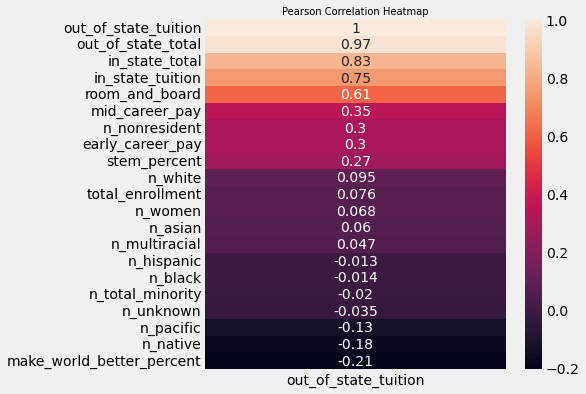

In [18]:
def corr(dataframe,i):
    plt.figure(figsize=(6, 6))
    heatmap = sns.heatmap(pd.DataFrame(dataframe[dataframe.columns[1:]].corr()[i][:]).sort_values(ascending=False,by=i), annot=True)
    heatmap.set_title('Pearson Correlation Heatmap', fontdict={'fontsize':10}, pad=5);
    
corr(df,'out_of_state_tuition')

The strongest correlation with respect to out_of_state_tuition is out_of_state_total.

### 2. Describe and interpret what you can see in this correlation plot. Any unusual occurrences? [3]

In the pearson correlation heatmap, we can observe the most correlated or variables which are highly proportional to out_of_state_tuition are out_of_state_total, in_state_total, in_state_tuition, room_and_board which are relted upto 60%. The reason could be, as these corresponds to the dollars which are costing to the students, and it do also calls for university profit of tuiton fees and room and board.<br> Further going there a drop of atleast 25% in comaparision to mid_career_pay. We can also observe n_nonresident and early_career_pay corresponds equal that is 30% correlation with out_of_state_tuition. <br>Henceforth, there is a sharp drop of values from 27% to 9.5% when comparision hits different type of student in the dataframe.<br> We can also see negative correlation of values to -1.3% to -21%. Which means that out_of_state_tuition are not much related with values lesser than 0.

### 3. Which three features correlate the most with make_world_better_percent, a percentage of alumni who make the world a better place? [1]

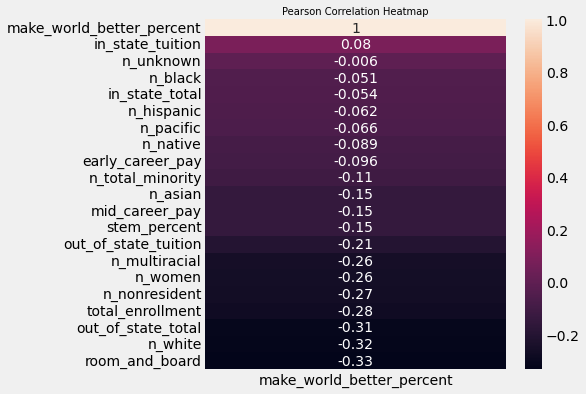

In [19]:
def corr1(dataframe,i):
    plt.figure(figsize=(6, 6))
    heatmap = sns.heatmap(pd.DataFrame(dataframe[dataframe.columns[1:]].corr()[i][:]).sort_values(ascending=False,by=i), annot=True)
    heatmap.set_title('Pearson Correlation Heatmap', fontdict={'fontsize':10}, pad=5);
    
corr1(df,'make_world_better_percent')

Three features correlate the most with make_world_better_percent are out_of_state_total, room_and_board and n_white. These three features are inversely correlated with make_world_better_place.

### 4. Choose the strongest of these three correlations and propose four hypotheses about the nature of the link between these variables. [4]

4 Hypothesis are:<br><br>
Hypothesis 1 - Lower is the cost of room_and_board, will have a positive impact on make_world_better_percent.<br><br>
Hypothesis 2 - More students belonging from different ethenicity, less will be the discrimination and it will also give a postive impact on make_world_better_percent. As there will young talent from all around the world. <br><br>
Hypothesis 3 - Lower the overall total cost of studying in University, more student will take addmission and probability of educated youth will increase which will make a positive impact on make_world_better_percent.<br><br>
Hypothesis 4 - More students means more research will be done by University which ultimately impact on make_world_better_percent.<br><br>

### 5. Which hypothesis do you find the most plausible? Which sources are there supporting it? [2]

The most plausible hypothesis I found is Hypothesis 4. The sources which support it are the number of students from different Ethenicity contributes high percentage of make_world_better_percent.

### 6. Which features do you lack in this dataset, which would have helped you determine whether your hypothesis is likely true? [1]

The feature which is lacking in dataset which would have determine my hypothesis to be true is "Research dataset". The number of research done by each University would have greatly contribute to prove my hypothesis true.

### 7. Explain the difference between Pearson and Spearman correlation coefficients. Which of them have you just used in this problem? Which of them would be more feasible for the analysis you are doing?[2]

In Pearson correlation the variables are directly proportional to each other, or we can say there is a linear relationship between two values. As the one change in one variable occurs, proportional change in other variable also occurs.<br><br>

In Spearman, there is monotonic relationship between two variables. Variable change togeather but not necessatily at constant rate.<br><br>

I have used Pearson correlation.<br><br>

Spearman correlation may have a better analysis.

### Problem 6: Correlation 2 [16 points]

Create new attributes by combining different features with each other.

In [20]:
dfethnicity = df.n_native+df.n_asian+df.n_black+df.n_hispanic+df.n_pacific+df.n_nonresident+df.n_total_minority+df.n_multiracial+df.n_unknown+df.n_white+df.n_women
dfethnicity

14       14054
33        1688
48        1261
70       20930
77        3275
         ...  
2075    107081
2078     35052
2083      7532
2096      2615
2124     12277
Length: 99, dtype: int64

In [21]:
dfmid = pd.merge(df, dfethnicity.to_frame(),left_index=True, right_index=True)
dfmid = dfmid.drop(["n_native","n_asian","n_black","Unnamed: 0","n_pacific","n_nonresident","n_total_minority","n_multiracial","stem_percent","n_unknown","n_white","n_women","state_code","room_and_board","in_state_tuition","n_hispanic"], axis=1)
dfmid.columns.values[11] = "ethnicity"

dfmid

,name,total_enrollment,state,type,degree_length,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,ethnicity
14,Alabama State University,5519,Alabama,Public,4 Year,16490,19396,24818,39800.0,71500.0,61.0,14054
33,Allen University,660,South Carolina,Private,4 Year,20570,13340,20570,NaN,NaN,NaN,1688
48,Amridge University,625,Alabama,Private,4 Year,6900,6900,6900,35700.0,65900.0,NaN,1261
70,Arkansas Tech University,12002,Arkansas,Public,4 Year,16938,15848,23718,45000.0,76900.0,54.0,20930
77,Asbury University,1879,Kentucky,Private,4 Year,37358,30198,37358,39400.0,70800.0,59.0,3275
...,...,...,...,...,...,...,...,...,...,...,...,...
2075,Western Governors University,57821,Utah,Private,4 Year,6670,6670,6670,54500.0,91500.0,57.0,107081
2078,Western Kentucky University,20171,Kentucky,Public,4 Year,18945,26496,34839,45500.0,83100.0,49.0,35052
2083,Western New Mexico University,3557,New Mexico,Public,4 Year,15960,15231,24367,41700.0,76700.0,75.0,7532
2096,Wheeling Jesuit University,1575,West Virginia,Private,4 Year,39190,29290,39190,44800.0,83400.0,57.0,2615


### 1. Explain why you think a combination will be useful before you create them. [2]

The newly created combination "dfmid" is useful as I have combined all the different ethnicity into one which reduces the size and complexity of dataset drastically. Moving forward I removed more features as there were already combined into one. This combination now give a proper visualization of datas which may postively impact the dataset.

### 2. Check their correlation with the out_of_state_tuition in comparison with the other features from before. Show the correlations with the target feature in a descending order. [2]

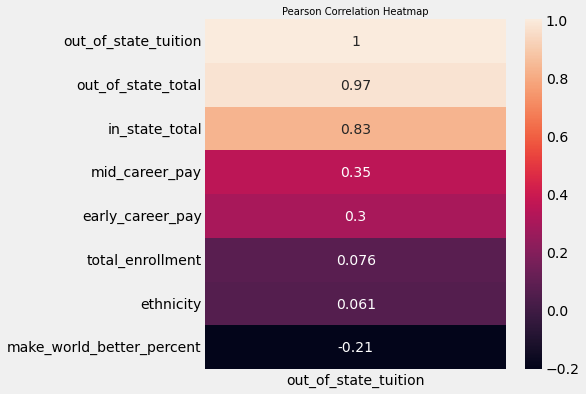

In [22]:
# Heat map of newly created dataset with respect to out_of_state_tuition
def make_corr(dataframe,i):
    plt.figure(figsize=(6, 6))
    heatmap = sns.heatmap(pd.DataFrame(dataframe[dataframe.columns[1:]].corr()[i][:]).sort_values(ascending=False,by=i), annot=True)
    heatmap.set_title('Pearson Correlation Heatmap', fontdict={'fontsize':10}, pad=5);
    
make_corr(dfmid,'out_of_state_tuition')

### 3. Do your newly created features have higher correlation with the target feature? [1]

Yes, as represented from the above heatmap, I find these features to have higher correlation with out_of_state_tuition.

### 4. Take a look at the data from tuition_income dataset and decide which features or combinations of features you think will also be beneficial for prediction. Repeat steps 1-3 for them. Note that you may need to make some extra transformations to add them. [4]

In [23]:
dftution.head()
dfmerge = pd.merge(dfmid,dftution,how="inner",on = "name")
dftuiton_filter = dftution[dftution["name"].isin(dfmerge.name.unique().tolist())]
dftuiton_filter = pd.concat([dftuiton_filter,pd.get_dummies(dftuiton_filter.income_lvl)],axis = 1).drop("income_lvl",axis=1)
dftuiton_filter_merge = pd.DataFrame()
low = []
mid = []
high = []
veryhigh = []
highest = []
total_price = []
year = []
campus = []
net_cost=[]
income_lvl = []

for i in dftuiton_filter.name.unique():
    temp = dftuiton_filter[dftuiton_filter["name"]==i]
    total_price.append(temp["total_price"].median())
    year.append(temp['year'].mode(dropna = True).iloc[0])
    campus.append(temp['campus'].mode(dropna = True).iloc[0])
    net_cost.append(temp['net_cost'].median())
    low.append(temp["0 to 30,000"].sum())
    mid.append(temp["30,001 to 48,000"].sum())
    high.append(temp["48_001 to 75,000"].sum())
    veryhigh.append(temp["75,001 to 110,000"].sum())
    highest.append(temp['Over 110,000'].sum())
    

dftuiton_filter_merge["name"] = dftuiton_filter.name.unique().tolist()
dftuiton_filter_merge["year"] = year
dftuiton_filter_merge["total_price"] = total_price
dftuiton_filter_merge["net_cost"] = net_cost
dftuiton_filter_merge["0 to 30,000"] = low
dftuiton_filter_merge["30,001 to 48,000"] = mid
dftuiton_filter_merge["48,001 to 75,000"] = high
dftuiton_filter_merge["75,001 to 110,000"] = veryhigh
dftuiton_filter_merge["Over 110,000"] = highest
dftuiton_filter_merge["campus"] = campus

In [24]:
dfuni_tuition_combined = pd.merge(dfmid,dftuiton_filter_merge,how="inner",on = "name")

In [25]:
# Displaying merge dataset of university and tuition income.
dfuni_tuition_combined

,name,total_enrollment,state,type,degree_length,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,ethnicity,year,total_price,net_cost,"0 to 30,000","30,001 to 48,000","48,001 to 75,000","75,001 to 110,000","Over 110,000",campus
0,Alabama State University,5519,Alabama,Public,4 Year,16490,19396,24818,39800.0,71500.0,61.0,14054,2011,20174.0,12430.000000,17,17,17,17,17,Off Campus
1,Allen University,660,South Carolina,Private,4 Year,20570,13340,20570,NaN,NaN,NaN,1688,2011,21240.0,16116.000000,17,17,17,17,16,Off Campus
2,Amridge University,625,Alabama,Private,4 Year,6900,6900,6900,35700.0,65900.0,NaN,1261,2017,19600.0,9035.915493,8,7,2,2,2,Off Campus
3,Arkansas Tech University,12002,Arkansas,Public,4 Year,16938,15848,23718,45000.0,76900.0,54.0,20930,2011,21184.0,11585.000000,17,17,17,17,17,Off Campus
4,Asbury University,1879,Kentucky,Private,4 Year,37358,30198,37358,39400.0,70800.0,59.0,3275,2011,36914.0,25727.500000,16,16,16,16,16,Off Campus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,Western Governors University,57821,Utah,Private,4 Year,6670,6670,6670,54500.0,91500.0,57.0,107081,2010,13870.0,11215.000000,8,8,8,8,7,Off Campus
82,Western Kentucky University,20171,Kentucky,Public,4 Year,18945,26496,34839,45500.0,83100.0,49.0,35052,2014,20547.0,15135.000000,15,15,15,15,11,On Campus
83,Western New Mexico University,3557,New Mexico,Public,4 Year,15960,15231,24367,41700.0,76700.0,75.0,7532,2014,20803.0,13414.000000,17,17,15,12,8,Off Campus
84,Wheeling Jesuit University,1575,West Virginia,Private,4 Year,39190,29290,39190,44800.0,83400.0,57.0,2615,2011,36070.0,17875.000000,17,17,17,17,17,Off Campus


The combination is useful because it narrow down data to more specific dataset which contain all the useful information needed.

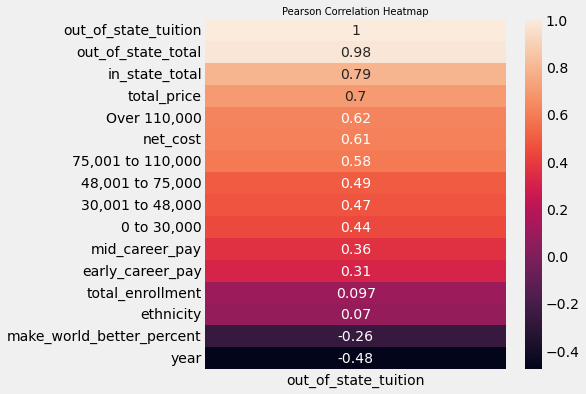

In [26]:
# Correlation heatmap of combine datatset with out_of_state_tuition
def corr(dataframe,i):
    plt.figure(figsize=(6, 6))
    heatmap = sns.heatmap(pd.DataFrame(dataframe[dataframe.columns[1:]].corr()[i][:]).sort_values(ascending=False,by=i), annot=True)
    heatmap.set_title('Pearson Correlation Heatmap', fontdict={'fontsize':10}, pad=5);
    
corr1(dfuni_tuition_combined,'out_of_state_tuition')

Yes, my newly created features are having higher correlation with the target feature that is out_of_state_tuition.

### 8. Do any of your new features shine the new light on possible determinants of what makes students feel they are making the world the better place? Explain your insights. [2]

If we compare both the heat map that is <b>Correlation heatmap of combine datatset with out_of_state_tuition</b> and <b> Heat map of newly created dataset with respect to out_of_state_tuition</b>, we will not see much difference on make_world_better_percent. In Correlation heatmap of combine datatset with out_of_state_tuition the value is -0.26 and in Heat map of newly created dataset with respect to out_of_state_tuition is -0.21 i.e.; there is only a growth of -0.05 units value.

### Problem 7: Data cleaning [10 points]

### 1. Find out which variables contain missing values. If there are any, how many values are missing? [2]

In [27]:
dfuni_tuition_combined.isnull().sum() * 100 / len(dfuni_tuition_combined)

name                          0.00000
total_enrollment              0.00000
state                         0.00000
type                          0.00000
degree_length                 0.00000
in_state_total                0.00000
out_of_state_tuition          0.00000
out_of_state_total            0.00000
early_career_pay             16.27907
mid_career_pay               16.27907
make_world_better_percent    17.44186
ethnicity                     0.00000
year                          0.00000
total_price                   0.00000
net_cost                      0.00000
0 to 30,000                   0.00000
30,001 to 48,000              0.00000
48,001 to 75,000              0.00000
75,001 to 110,000             0.00000
Over 110,000                  0.00000
campus                        0.00000
dtype: float64

### 2. Which approaches exist for handling missing data? Describe two approaches of how to handle them. Write one advantage and one disadvantage for each of those methods. [4]

Approaches exist for handling missing data are: Multiple Imputatuion and K Nearest Neighbors(KNN)<br><br>
Multiple Imputation: It is mainly for large dataset. In this uses subsituting data in place of  missing data.<br>
Advantage: Results are readily interpreted.<br>
Disadvantage:It assumes a random data in place of missing data.<br><br>
KNN: This method uses Eucliden distance between neighbouring data cordinates to know how similar data is.<br>
Advantage: It do not assumes data.<br>
Disadvamtage: Since it stores all training data, hence it requires large memory capacity.


### 3. Handle the missing data by methods you find the most suitable. Explain how you chose the method for each column. [3]

In [28]:
# Handling missing datas.
dfuni_tuition_combined_imputation = dfuni_tuition_combined.fillna(dfuni_tuition_combined.mean())

In [29]:
dfuni_tuition_combined_imputation.head()

,name,total_enrollment,state,type,degree_length,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,ethnicity,year,total_price,net_cost,"0 to 30,000","30,001 to 48,000","48,001 to 75,000","75,001 to 110,000","Over 110,000",campus
0,Alabama State University,5519,Alabama,Public,4 Year,16490,19396,24818,39800.000000,71500.000000,61.000000,14054,2011,20174.0,12430.000000,17,17,17,17,17,Off Campus
1,Allen University,660,South Carolina,Private,4 Year,20570,13340,20570,45369.444444,81719.444444,57.464789,1688,2011,21240.0,16116.000000,17,17,17,17,16,Off Campus
2,Amridge University,625,Alabama,Private,4 Year,6900,6900,6900,35700.000000,65900.000000,57.464789,1261,2017,19600.0,9035.915493,8,7,2,2,2,Off Campus
3,Arkansas Tech University,12002,Arkansas,Public,4 Year,16938,15848,23718,45000.000000,76900.000000,54.000000,20930,2011,21184.0,11585.000000,17,17,17,17,17,Off Campus
4,Asbury University,1879,Kentucky,Private,4 Year,37358,30198,37358,39400.000000,70800.000000,59.000000,3275,2011,36914.0,25727.500000,16,16,16,16,16,Off Campus


While cleaning the data we observed 3 features that is are early_career_pay, mid_career_pay, make_world_better_percent denotes missing values. So I implemented Multiple Imputation technique to fill the missing values as thats is the best technique for large dataset.

In [30]:
# Splitting values into train and test set with 70% versus 30% ratio, respectively.
dfuni_tuition_combined_imputation.drop(["name"],inplace=True,axis=1) 
dfuni_tuition_combined_imputation["year"] = dfuni_tuition_combined_imputation.year.apply(str)
X = dfuni_tuition_combined_imputation.loc[:, dfuni_tuition_combined_imputation.columns != 'out_of_state_tuition']
y = dfuni_tuition_combined_imputation['out_of_state_tuition']

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=dfuni_tuition_combined_imputation['degree_length'], 
                                                    test_size=0.3,random_state = 131)


### 4. Handle the categorical data with one-hot-encoding. [1]

In [31]:
X_train = pd.get_dummies(X_train)
X_test = pd.get_dummies(X_test)

### Problem 8: Feature scaling [9 points]

### 1. What feature scaling methods exist? Name five methods and write a short description for three of them. Pick one to use for this data set. [6]

Feature Scaling is the process by which we transform data into a better version. It is use to normalize the features in the dataset into a finite range.<br><br>
Five Feature Scaling methods are:<br><br>
<b>Absolute Maximum Scaling:</b> In this scaling, datas are scaled into maximum value and the results varies approximately within the range of -1 to 1<br><br>
<b>Min-Max Scaling:</b> It is feature pre-processing technique in which data are scaled in fixed range of 0 to 1.<br><br>
<b>Normalization:</b> It is the feature by which numeric columns in dataset changes to common scale.<br><br>
<b>Standardization:</b> In this method the datas are converted into uniform format which is further used to different operations.<br><br>
<b>Robust Scaling:</b> In this the algorithm scale features that are robust to outliers.

In [32]:
dfuni_tuition_combined_imputation.head()

,total_enrollment,state,type,degree_length,in_state_total,out_of_state_tuition,out_of_state_total,early_career_pay,mid_career_pay,make_world_better_percent,ethnicity,year,total_price,net_cost,"0 to 30,000","30,001 to 48,000","48,001 to 75,000","75,001 to 110,000","Over 110,000",campus
0,5519,Alabama,Public,4 Year,16490,19396,24818,39800.000000,71500.000000,61.000000,14054,2011,20174.0,12430.000000,17,17,17,17,17,Off Campus
1,660,South Carolina,Private,4 Year,20570,13340,20570,45369.444444,81719.444444,57.464789,1688,2011,21240.0,16116.000000,17,17,17,17,16,Off Campus
2,625,Alabama,Private,4 Year,6900,6900,6900,35700.000000,65900.000000,57.464789,1261,2017,19600.0,9035.915493,8,7,2,2,2,Off Campus
3,12002,Arkansas,Public,4 Year,16938,15848,23718,45000.000000,76900.000000,54.000000,20930,2011,21184.0,11585.000000,17,17,17,17,17,Off Campus
4,1879,Kentucky,Private,4 Year,37358,30198,37358,39400.000000,70800.000000,59.000000,3275,2011,36914.0,25727.500000,16,16,16,16,16,Off Campus


In [33]:
# Performing Standardization method for my dataset.

from sklearn.preprocessing import StandardScaler
def scal_independent(DataFrame):
    scale = StandardScaler()
    cols = ['total_enrollment','in_state_total', 'out_of_state_total','early_career_pay', 'mid_career_pay', 
            'make_world_better_percent','total_price', 'net_cost','ethnicity']
    DataFrame[cols] = scale.fit_transform(DataFrame[cols])
    
    return DataFrame

def scal_dependent(DataFrame):
    dataframe = scale(DataFrame)
    return dataframe

X_train = scal_independent(X_train)
X_test = scal_independent(X_test)
y_train = scal_dependent(y_train)
y_test = scal_dependent(y_test)

In [34]:
# Dropping non-numeric features from imputed dataset.

X_train.drop(list(set(X_train.columns.tolist())- set(X_test.columns.tolist())),axis=1,inplace=True)

In [35]:
X_test.drop('state_Montana',inplace = True, axis = 1)

### 2. Find the feature importance with a quick Random Forest and show them in a plot. What insights do you get out of it? [3]

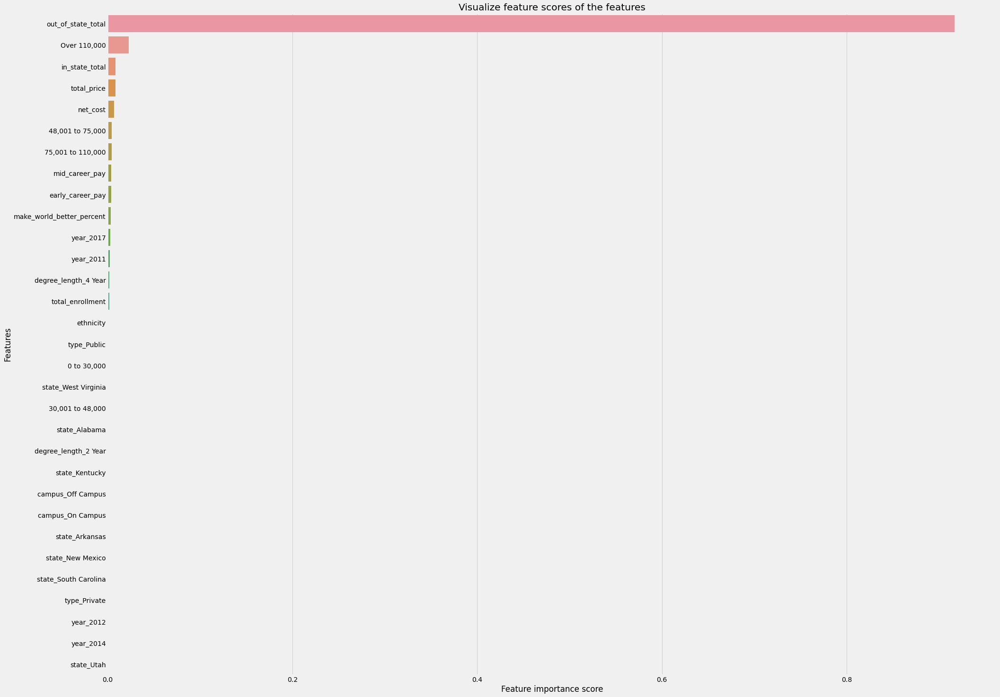

In [36]:
from sklearn.datasets import make_regression
X, y = make_regression(n_samples=165, n_features=52, n_informative=5, random_state=1)
mdl = RandomForestRegressor()
mdl.fit(X_train, y_train)
feature_scores = pd.Series(mdl.feature_importances_, index=X_train.columns).sort_values(ascending=False)
f, ax = plt.subplots(figsize=(30, 24))
ax = sns.barplot(x=feature_scores, y=feature_scores.index, data=df)
ax.set_title("Visualize feature scores of the features")
ax.set_yticklabels(feature_scores.index)
ax.set_xlabel("Feature importance score")
ax.set_ylabel("Features")
plt.show()

I can observe that not much feature shows up with the Random Forest feature scaling method.

### Problem 9: Test data [6 points]

Perform the same data cleaning steps from questions 7 and 8 for the test data set. (Replace missing
values, handle the categorical data, add the new features, and scale the features) [6]

#### Already perform above in question 7 & 8.

### Problem 10: Regression [19 points]

Select and train the following regression models on the training set. Linear model, support vector
regression, and random forest. 

### 1. Evaluate the three regression models on the test set. Which model performs best? [9]

In [37]:
# Performing Linear Regression.

r =LinearRegression()
model = r.fit(X_train, y_train)
y_pred = r.predict(X_test)
residuals = y_test - y_pred
mae = round(metrics.mean_absolute_error(y_test, y_pred),2)
mse = round(metrics.mean_squared_error(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
mape = round(np.mean(abs(residuals/y_test)),2)
accuracy = str(100-(round(np.mean(abs(residuals/y_test)),4)*100)) +' %'
nRMSE = round((rmse/70.127909),2)
aError = round(np.mean(abs(residuals)),2)
error_df = pd.DataFrame(data = [[mae, mse, rmse,mape, accuracy, nRMSE,aError]], 
                        columns = ['MAE', 'MSE', 'RMSE','MAPE','Model Accuracy','Normalized RMSE','Average Error'], 
                        index = ['Linear Regression'])
print(error_df)

                    MAE   MSE  RMSE  MAPE         Model Accuracy  \
Linear Regression  0.28  0.15  0.39  1.03  -2.8799999999999955 %   

                   Normalized RMSE  Average Error  
Linear Regression             0.01           0.28  


In [38]:
# Performing Random Forest Regression
r = RandomForestRegressor()
model = r.fit(X_train, y_train)
y_pred = r.predict(X_test)
residuals = y_test - y_pred
mae = round(metrics.mean_absolute_error(y_test, y_pred),2)
mse = round(metrics.mean_squared_error(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
mape = round(np.mean(abs(residuals/y_test)),2)
accuracy = str(100-(round(np.mean(abs(residuals/y_test)),4)*100)) +' %'
nRMSE = round((rmse/70.127909),2)
aError = round(np.mean(abs(residuals)),2)
error_df = pd.DataFrame(data = [[mae, mse, rmse,mape, accuracy, nRMSE,aError]], 
                        columns = ['MAE', 'MSE', 'RMSE','MAPE','Model Accuracy','Normalized RMSE','Average Error'], 
                        index = ['Random Forest Regression'])
print(error_df)

                           MAE   MSE  RMSE  MAPE         Model Accuracy  \
Random Forest Regression  0.24  0.13  0.36   1.0  0.20999999999999375 %   

                          Normalized RMSE  Average Error  
Random Forest Regression             0.01           0.24  


In [39]:
# Performing Support Vector Regression
r =SVR ()
model = r.fit(X_train, y_train)
y_pred = r.predict(X_test)
residuals = y_test - y_pred
mae = round(metrics.mean_absolute_error(y_test, y_pred),2)
mse = round(metrics.mean_squared_error(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
mape = round(np.mean(abs(residuals/y_test)),2)
accuracy = str(100-(round(np.mean(abs(residuals/y_test)),4)*100)) +' %'
nRMSE = round((rmse/70.127909),2)
aError = round(np.mean(abs(residuals)),2)
error_df = pd.DataFrame(data = [[mae, mse, rmse,mape, accuracy, nRMSE,aError]], 
                        columns = ['MAE', 'MSE', 'RMSE','MAPE','Model Accuracy','Normalized RMSE','Average Error'], 
                        index = ['SVR'])
print(error_df)

     MAE   MSE  RMSE  MAPE         Model Accuracy  Normalized RMSE  \
SVR  0.6  0.56  0.75  1.23  -23.200000000000003 %             0.01   

     Average Error  
SVR            0.6  


#####  Solution: 
Random forest model performs the best.

### 2. Explain one approach about how the models can be further optimized. [3] 

One approach by which a model can be further be optimize is through isotonic regression. Isotonic Regression is a technique by which a free-form line is fitted to a sequence of observation in such a way that fitted line is neither non-decreasing or non-increasing everywhere rather should be close to the observation as much as possible.

### 3. Based on the data you have at hand and your background knowledge, which problems might you encounter when trying use your best model to predict out-of-state tuition fee for the next year? [2] 

### 4. Name and explain two accuracy metrics for regression other than MSE or RMSE. Are any of them better suited for evaluating your models, given the goal you have formulated earlier? [2]

Two accuracy model except MSE and MAPE are: <br><br> 
MAE (Mean Absolute Error): It is the average measure of errors in a set of models without taking vector into account.<br><br>
MAPE (Mean Absolute Percentage Error): It is the percentage of the average difference between forecasted and true values.<br><br>
Yes they both sucessfully suited for the evaluation of my model.


### 5. What has to change in real life to completely invalidate the results you get and accuracy of your model? I.e., what laws, natural events, societal changes have to happen to make conclusions based on this dataset inadmissible for further decision-making? [3]

If out_of_state_tuition and in_state_total feature gets invalidate, the results and accuracy of the whole model will become inaccurate. If such a law is passed that no fees will be taken by the students the dataset will become inadmissible for further decision making. 

### Problem 11: Classification [21 points]

Categorize the target variable (out_of_state_tuition) into five categories and build a classification model
for the above pre-processed data.

### 1. Train the following classification models on the training set for classification and evaluate the models on the test set: SVM, k-NN, and Random Forest. [9]

In [40]:
# Function for classification.
def classification(Xtrain, Xtest, ytrain, ytest, classifier):
    cls = classifier
    cls.fit(Xtrain, ytrain)
    ypred = cls.predict(Xtest)
    print(f"Accuracy of the classifier is: {accuracy_score(ytest, ypred)}")
    print(f"Precision Score of the classifier is: {precision_score(ytest, ypred,average='macro')}")
    print(f"Recall Score of the classifier is: {recall_score(ytest, ypred,average='macro')}")
    print(f"F1 Score of the classifier is: {f1_score(ytest, ypred,average='macro')}")
    plot_confusion_matrix(classifier, Xtest, ytest)


In [41]:
# Creating bins for y_train and y_test
y_train_class = pd.cut(y_train, bins = [-3,-1,0,1,3,4], include_lowest = True, labels=[1,2,3,4,5])
y_test_class = pd.cut(y_test, bins = [-3,-1,0,1,3,4], include_lowest = True, labels=[1,2,3,4,5])

Accuracy of the classifier is: 0.46153846153846156
Precision Score of the classifier is: 0.484375
Recall Score of the classifier is: 0.4375
F1 Score of the classifier is: 0.4053030303030303


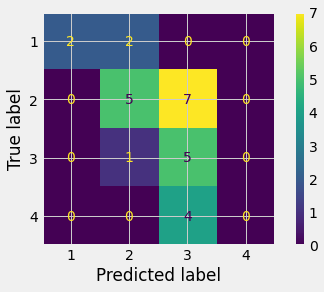

In [42]:
# Plotting Confusion matrix for model k-NN 
classification(X_train, X_test, y_train_class, y_test_class, KNeighborsClassifier())

Accuracy of the classifier is: 0.3076923076923077
Precision Score of the classifier is: 0.3125
Recall Score of the classifier is: 0.375
F1 Score of the classifier is: 0.26666666666666666


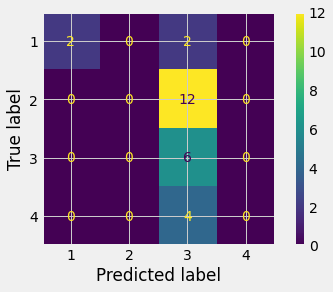

In [43]:
# Plotting Confusion matrix for model SVM 
classification(X_train, X_test, y_train_class, y_test_class, SVC())

Accuracy of the classifier is: 0.9230769230769231
Precision Score of the classifier is: 0.9642857142857143
Recall Score of the classifier is: 0.8958333333333334
F1 Score of the classifier is: 0.9223276723276723


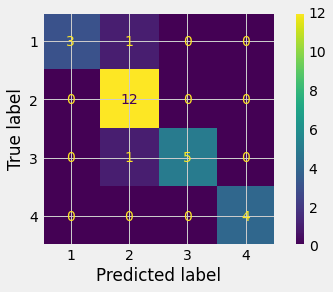

In [44]:
# Plotting Confusion matrix for model Random Forest
classification(X_train, X_test, y_train_class, y_test_class, RandomForestClassifier())

### 3. Which model performs best based on which evaluation method? [2]

Random Forest perform best on our model. The can be seen by the accuracy of the classifier which is 88.4615% approx

### 4. Explain the evaluation method you used. [2]

The evaluation method I have used here are: <br><br>
<b>SVM:</b> SVM is a supervised learning method. These are used in high dimenation spaces.<br><br><b>k-NN:</b> This method does not make assumption on underlying datas. It perform action at the time of classifcation, hence it is also known as lazy lerner algorithm.<br><br>and,<br><br> <b>Random Forest:</b> It uses ensemble learning that is it combines classifiers to perform solution to complex problem.

### 5. For which applications would classification into these artificial categories be more useful than regression? Name at least two. [2]

Application where classification will be more useful than regression is when there will discrete value. In these artificial category we can opt for "type" and "degree_length".

### 6. For which applications would regression on original values be more useful? Name at least two. [2]

Regression is used in contunues values. Here we can use in "out_of_state_total" and "total_enrollment"

### Part 2

### Problem 12: Text Mining [40 points]

The dataset GoodReads.csv contains book descriptions. Load this dataset and draw random sample of size 5000 from it, setting the seed to 45.

In [45]:
Goodreads = pd.read_csv('GoodReads.csv')
Goodreads.head()

,author,bookformat,desc,genre,img,isbn,isbn13,link,pages,rating,reviews,title,totalratings
0,Laurence M. Hauptman,Hardcover,Reveals that several hundred thousand Indians ...,"History,Military History,Civil War,American Hi...",https://i.gr-assets.com/images/S/compressed.ph...,002914180X,9.78E+12,https://goodreads.com/book/show/1001053.Betwee...,0,3.52,5,Between Two Fires: American Indians in the Civ...,33
1,"Charlotte Fiell,Emmanuelle Dirix",Paperback,Fashion Sourcebook - 1920s is the first book i...,"Couture,Fashion,Historical,Art,Nonfiction",https://i.gr-assets.com/images/S/compressed.ph...,1906863482,9.78E+12,https://goodreads.com/book/show/10010552-fashi...,576,4.51,6,Fashion Sourcebook 1920s,41
2,Andy Anderson,Paperback,The seminal history and analysis of the Hungar...,"Politics,History",https://i.gr-assets.com/images/S/compressed.ph...,948984147,9.78E+12,https://goodreads.com/book/show/1001077.Hungar...,124,4.15,2,Hungary 56,26
3,Carlotta R. Anderson,Hardcover,"""All-American Anarchist"" chronicles the life a...","Labor,History",https://i.gr-assets.com/images/S/compressed.ph...,814327079,9.78E+12,https://goodreads.com/book/show/1001079.All_Am...,324,3.83,1,All-American Anarchist: Joseph A. Labadie and ...,6
4,Jean Leveille,NaN,"Aujourdâ€™hui, lâ€™oiseau nous invite Ã sa ta...",NaN,https://i.gr-assets.com/images/S/compressed.ph...,2761920813,NaN,https://goodreads.com/book/show/10010880-les-o...,177,4.00,1,Les oiseaux gourmands,1


In [46]:
# dfgr is the name of the data frame of Good Reads book

dfgr = Goodreads.sample(n=5000, random_state=45)
dfgr.head()

,author,bookformat,desc,genre,img,isbn,isbn13,link,pages,rating,reviews,title,totalratings
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",https://i.gr-assets.com/images/S/compressed.ph...,NaN,NaN,https://goodreads.com/book/show/13610173-you-a...,77,3.81,501,You Are A Writer (So Start Acting Like One),3278
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",https://i.gr-assets.com/images/S/compressed.ph...,373829043,9.78E+12,https://goodreads.com/book/show/12403714-homet...,320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",https://i.gr-assets.com/images/S/compressed.ph...,373277369,9.78E+12,https://goodreads.com/book/show/11049207-sworn...,222,3.94,6,Sworn to Protect,52
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,NaN,NaN,https://i.gr-assets.com/images/S/compressed.ph...,NaN,NaN,https://goodreads.com/book/show/13635365-memor...,0,3.67,1,Memorials of a Southern Planter:,9
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",https://i.gr-assets.com/images/S/compressed.ph...,NaN,NaN,https://goodreads.com/book/show/12804726-indep...,12,3.12,12,Independence,41


### 1. Plot and describe the distribution of average ratings of the books.[2]

In [47]:
fig = px.histogram(x = dfgr['rating'], width=800, marginal='box', labels={'col':'col'})
fig.update_layout(title = 'Average Ratings of books')
fig.show()

### 2. Clean the data in your dataframe. Explain your reasoninng for selecting the cleaning methods you decided to use.[3]

In [48]:
dfgr = dfgr.drop(['img', 'isbn', 'isbn13', 'link'], axis = 1)
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,NaN,NaN,0,3.67,1,Memorials of a Southern Planter:,9
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41


I decided to drop image, link and isbn, because, img and link are the web-links for the picture and the PDF file of the book, I also ommitted the isbn, which will not be using.

### 3. Categorize the rating variable into several categories. Explain how many categories you decided to have, where you drew the line, and why you decided to do it this way[5]

In [49]:
category = pd.cut(dfgr['rating'], bins = [0, 1, 2, 3, 4, 5.1], include_lowest = True, labels=['Very Poor', 
                                                                                          'Poor', 
                                                                                          'Neutral',
                                                                                          'Good',
                                                                                          'Very Good'])
dfgr['Rating Category'] = category
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,NaN,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good


### 4. Get a feel about the distribution of text lengths of the book descriptions by adding a new feature for the length of each message. Check the statistical values. [2]

In [50]:
msgLen = dfgr['desc'].str.len()
dfgr['Description Length'] = msgLen
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,NaN,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0


### 5. Visualize the distribution of text lengths with a histogram, where the colouring is according to the rating category. [2]

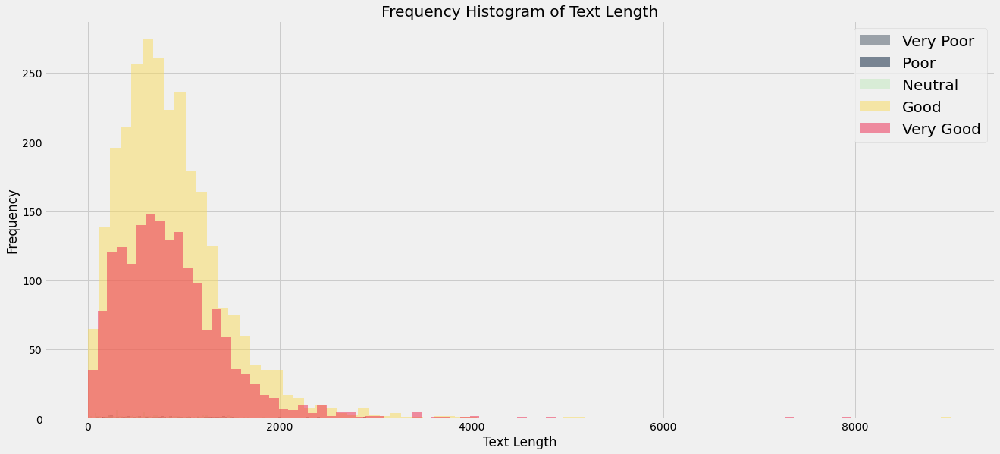

In [51]:
x1 = dfgr.loc[dfgr['Rating Category'] == 'Very Poor', 'Description Length']
x2 = dfgr.loc[dfgr['Rating Category'] == 'Poor', 'Description Length']
x3 = dfgr.loc[dfgr['Rating Category'] == 'Neutral', 'Description Length']
x4 = dfgr.loc[dfgr['Rating Category'] == 'Good', 'Description Length']
x5 = dfgr.loc[dfgr['Rating Category'] == 'Very Good', 'Description Length']

kwargs = dict(alpha = 0.5, bins = 80)

plt.figure(figsize=(20,9))
plt.hist(x1, **kwargs, color='#465362', label='Very Poor')
plt.hist(x2, **kwargs, color='#011936', label='Poor')
plt.hist(x3, **kwargs, color='#C2EABD', label='Neutral')
plt.hist(x4, **kwargs, color='#F9DC5C', label='Good')
plt.hist(x5, **kwargs, color='#ED254E', label='Very Good')
plt.gca().set(title = 'Frequency Histogram of Text Length',  ylabel = 'Frequency', xlabel = 'Text Length')
plt.legend(loc = 'upper right', prop = {'size': 20});

### 6. Create a random stratified training and test split (70/30 split). Verify the correct proportions of the splitted data sets by creating proportion table. [1]

In [52]:
X = dfgr.loc[:, dfgr.columns != 'Description Length']
y = dfgr['Description Length']

X_train, X_test, y_train, y_test = train_test_split(X, y,stratify=dfgr['Rating Category'],test_size=0.3)

grStr = {'X': [len(X_train)/(len(X_train)+len(X_test)),len(X_test)/(len(X_train)+len(X_test))],
                     'Y': [len(y_train)/(len(y_train)+len(y_test)),len(y_test)/(len(y_train)+len(y_test))]}

grProportion = pd.DataFrame(grStr)
grProportion.head()

,X,Y
0,0.7,0.7
1,0.3,0.3


In [53]:
# Train dataset

Xtrain_tab = pd.crosstab(index = X_train['Rating Category'],  
                         columns = 'Count') 
Xtrain_tab

col_0,Count
Rating Category,
Very Poor,48
Poor,5
Neutral,92
Good,2031
Very Good,1324


In [54]:
# Test dataset

Xtest_tab = pd.crosstab(index = X_test['Rating Category'],  
                        columns = 'Count')

Xtest_tab

col_0,Count
Rating Category,
Very Poor,21
Poor,2
Neutral,40
Good,870
Very Good,567


### 7. Tokenize the descriptions with help of the quanteda package and illustrate the effect of each action by showing the content of some of the reviews in the training data set:

Remove the numbers, punctuations, symbols, and hyphens. Turn the texts in the reviews into lower case. Remove the stopwords in the modified training set (the tokens) with the predefined stopword list of quanteda. Perform stemming on the tokens. [5]

In [55]:
import nltk
from nltk.tokenize import sent_tokenize
nltk.download('punkt')
nltk.download('stopwords')
import string
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Tanzil\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Tanzil\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [56]:
# Getting rid of NaN in the description column, to prepare it for tokenization

dfgr['desc']=dfgr['desc'].fillna('')
dfgr.head(40)

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0
29228,Gordon Pirie,ebook,,"Nonfiction,Health,Sports,Fitness,Biography,Spo...",59,4.10,17,Running Fast and Injury Free,146,Very Good,NaN
81974,Tedd Arnold,Hardcover,"Gert loves dirt. She rolls in it, digs in it, ...","Childrens,Picture Books,Childrens,Humor,Enviro...",32,3.40,94,Dirty Gert,394,Good,790.0
15747,Thomas H. O'Connor,Paperback,"""Here is one of the great stories in American ...","History,Nonfiction,Cities,Urban Studies",368,3.64,7,Building A New Boston: Politics and Urban Rene...,33,Good,622.0
14926,Jennifer Johnston,Paperback,Derry in the 1970s: teenager Joe Logan is grow...,"Fiction,European Literature,Irish Literature,C...",224,3.87,49,Shadows on our Skin,374,Good,460.0
14175,Bart Yates,Paperback,Noah York is a closeted gay teenager with a fo...,"LGBT,Young Adult,Fiction,Romance,M M Romance,L...",256,4.09,169,Leave Myself Behind,2489,Very Good,757.0


In [57]:
# Creating the new string with lowercase desctiption

dfgr['Lower Case'] = dfgr['desc'].str.lower() 
dfgr.head(25)

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length,Lower Case
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0,becoming a writer begins with a simple but imp...
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0,after years traveling in europe with her music...
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0,iris beaudoin has always been a pain in sundan...
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN,
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0,this was a free story offered at dreamspinner ...
29228,Gordon Pirie,ebook,,"Nonfiction,Health,Sports,Fitness,Biography,Spo...",59,4.10,17,Running Fast and Injury Free,146,Very Good,NaN,
81974,Tedd Arnold,Hardcover,"Gert loves dirt. She rolls in it, digs in it, ...","Childrens,Picture Books,Childrens,Humor,Enviro...",32,3.40,94,Dirty Gert,394,Good,790.0,"gert loves dirt. she rolls in it, digs in it, ..."
15747,Thomas H. O'Connor,Paperback,"""Here is one of the great stories in American ...","History,Nonfiction,Cities,Urban Studies",368,3.64,7,Building A New Boston: Politics and Urban Rene...,33,Good,622.0,"""here is one of the great stories in american ..."
14926,Jennifer Johnston,Paperback,Derry in the 1970s: teenager Joe Logan is grow...,"Fiction,European Literature,Irish Literature,C...",224,3.87,49,Shadows on our Skin,374,Good,460.0,derry in the 1970s: teenager joe logan is grow...
14175,Bart Yates,Paperback,Noah York is a closeted gay teenager with a fo...,"LGBT,Young Adult,Fiction,Romance,M M Romance,L...",256,4.09,169,Leave Myself Behind,2489,Very Good,757.0,noah york is a closeted gay teenager with a fo...


In [58]:
# Getting rid of the punctuations in the Lower Case variable

dfgr['Lower Case'] = dfgr['Lower Case'].str.replace('[^\w\s]', '')
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length,Lower Case
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0,becoming a writer begins with a simple but imp...
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0,after years traveling in europe with her music...
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0,iris beaudoin has always been a pain in sundan...
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN,
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0,this was a free story offered at dreamspinner ...


In [59]:
# Deleting stopwords

stop = stopwords.words('english')
dfgr['Without Stopwords'] = dfgr['Lower Case'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length,Lower Case,Without Stopwords
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0,becoming a writer begins with a simple but imp...,becoming writer begins simple important belief...
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0,after years traveling in europe with her music...,years traveling europe musician husband widow ...
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0,iris beaudoin has always been a pain in sundan...,iris beaudoin always pain sundance jonsons sid...
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN,,
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0,this was a free story offered at dreamspinner ...,free story offered dreamspinner press 2011 par...


In [60]:
# Create a new column with tokenized lowercase column

dfgr['Tokenized Description'] = dfgr.apply(lambda row: nltk.word_tokenize(row['Without Stopwords']), axis = 1)
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length,Lower Case,Without Stopwords,Tokenized Description
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0,becoming a writer begins with a simple but imp...,becoming writer begins simple important belief...,"[becoming, writer, begins, simple, important, ..."
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0,after years traveling in europe with her music...,years traveling europe musician husband widow ...,"[years, traveling, europe, musician, husband, ..."
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0,iris beaudoin has always been a pain in sundan...,iris beaudoin always pain sundance jonsons sid...,"[iris, beaudoin, always, pain, sundance, jonso..."
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN,,,[]
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0,this was a free story offered at dreamspinner ...,free story offered dreamspinner press 2011 par...,"[free, story, offered, dreamspinner, press, 20..."


In [61]:
# Stemming

stemmer = SnowballStemmer('english')
dfgr['Stemmed Token'] = dfgr['Tokenized Description'].apply(lambda x: [stemmer.stem(y) for y in x])
dfgr.head()

,author,bookformat,desc,genre,pages,rating,reviews,title,totalratings,Rating Category,Description Length,Lower Case,Without Stopwords,Tokenized Description,Stemmed Token
57250,Jeff Goins,Kindle Edition,Becoming a writer begins with a simple but imp...,"Language,Writing,Nonfiction,Self Help,Business...",77,3.81,501,You Are A Writer (So Start Acting Like One),3278,Good,778.0,becoming a writer begins with a simple but imp...,becoming writer begins simple important belief...,"[becoming, writer, begins, simple, important, ...","[becom, writer, begin, simpl, import, belief, ..."
34573,"Ruth Axtell Morren,Patricia Davids",Paperback,After years traveling in Europe with her music...,"Category Romance,Love Inspired,Love Inspired,L...",320,3.93,12,Hometown Cinderella \ The Inn at Hope Springs,135,Good,659.0,after years traveling in europe with her music...,years traveling europe musician husband widow ...,"[years, traveling, europe, musician, husband, ...","[year, travel, europ, musician, husband, widow..."
15532,Kimberly Van Meter,Mass Market Paperback,Iris Beaudoin has always been a pain in Sundan...,"Romance,Romantic Suspense,Romance,Category Rom...",222,3.94,6,Sworn to Protect,52,Good,558.0,iris beaudoin has always been a pain in sundan...,iris beaudoin always pain sundance jonsons sid...,"[iris, beaudoin, always, pain, sundance, jonso...","[iri, beaudoin, alway, pain, sundanc, jonson, ..."
58088,"Susan Dabney Smedes,Fletcher M. Green",Hardcover,,NaN,0,3.67,1,Memorials of a Southern Planter:,9,Good,NaN,,,[],[]
40218,Clare London,ebook,This was a Free Story offered at Dreamspinner ...,"Romance,M M Romance,Erotica,BDSM,Contemporary,...",12,3.12,12,Independence,41,Good,318.0,this was a free story offered at dreamspinner ...,free story offered dreamspinner press 2011 par...,"[free, story, offered, dreamspinner, press, 20...","[free, stori, offer, dreamspinn, press, 2011, ..."


### 8. Create a bag-of-words model and add bi-grams to the normal feature matrix. [2]

In [62]:
vocab = []

for i in dfgr['Stemmed Token']:
    for x in i:
            vocab.append(x)
        
        
vocab

['becom',
 'writer',
 'begin',
 'simpl',
 'import',
 'belief',
 'writer',
 'need',
 'write',
 'writer',
 'jeff',
 'goin',
 'share',
 'stori',
 'selfdoubt',
 'took',
 'becom',
 'profession',
 'writer',
 'bestsel',
 'authorâand',
 'principl',
 'heâ',
 'learn',
 'see',
 'mani',
 'other',
 'give',
 'practic',
 'step',
 'improv',
 'write',
 'get',
 'publish',
 'build',
 'platform',
 'put',
 'charg',
 'book',
 'take',
 'writer',
 '21st',
 'centuri',
 'learn',
 'import',
 'passion',
 'disciplin',
 'show',
 'everi',
 'day',
 'work',
 'writer',
 'help',
 'fall',
 'back',
 'love',
 'write',
 'build',
 'audienc',
 'share',
 'love',
 'itâ',
 'live',
 'dream',
 'life',
 'dedic',
 'word',
 'year',
 'travel',
 'europ',
 'musician',
 'husband',
 'widow',
 'mara',
 'hoffman',
 'want',
 'secur',
 'son',
 'halfshar',
 'father',
 'main',
 'farmhous',
 'refug',
 'left',
 'even',
 'resent',
 'stepmoth',
 'treat',
 'mara',
 'littl',
 'servant',
 'one',
 'bright',
 'spot',
 'unexpect',
 'kind',
 'neighbor',
 

In [63]:
# Getting rid of duplicated values

vocabDupl = list(dict.fromkeys(vocab))
vocabDupl

['becom',
 'writer',
 'begin',
 'simpl',
 'import',
 'belief',
 'need',
 'write',
 'jeff',
 'goin',
 'share',
 'stori',
 'selfdoubt',
 'took',
 'profession',
 'bestsel',
 'authorâand',
 'principl',
 'heâ',
 'learn',
 'see',
 'mani',
 'other',
 'give',
 'practic',
 'step',
 'improv',
 'get',
 'publish',
 'build',
 'platform',
 'put',
 'charg',
 'book',
 'take',
 '21st',
 'centuri',
 'passion',
 'disciplin',
 'show',
 'everi',
 'day',
 'work',
 'help',
 'fall',
 'back',
 'love',
 'audienc',
 'itâ',
 'live',
 'dream',
 'life',
 'dedic',
 'word',
 'year',
 'travel',
 'europ',
 'musician',
 'husband',
 'widow',
 'mara',
 'hoffman',
 'want',
 'secur',
 'son',
 'halfshar',
 'father',
 'main',
 'farmhous',
 'refug',
 'left',
 'even',
 'resent',
 'stepmoth',
 'treat',
 'littl',
 'servant',
 'one',
 'bright',
 'spot',
 'unexpect',
 'kind',
 'neighbor',
 'gideon',
 'jakemana',
 'farmer',
 'teenag',
 'daughter',
 'hard',
 'pictur',
 'anyon',
 'princ',
 'charm',
 'especi',
 'woman',
 'refin',
 'yet

In [64]:
def convert(org_list, separator = ' '):
    
    return separator.join(org_list)

sentences = []

for j in dfgr['Stemmed Token']:
    sentence = ''
    sentence = convert(j)
    sentences.append(sentence)
    
sentences

['becom writer begin simpl import belief writer need write writer jeff goin share stori selfdoubt took becom profession writer bestsel authorâand principl heâ learn see mani other give practic step improv write get publish build platform put charg book take writer 21st centuri learn import passion disciplin show everi day work writer help fall back love write build audienc share love itâ live dream life dedic word',
 'year travel europ musician husband widow mara hoffman want secur son halfshar father main farmhous refug left even resent stepmoth treat mara littl servant one bright spot unexpect kind neighbor gideon jakemana widow farmer teenag daughter gideon hard pictur anyon princ charm especi woman mara refin yet quiet rug strength make feel though shes found right place side find faith enough forg happi end',
 'iri beaudoin alway pain sundanc jonson side recent shes becom sweet ach heart wish realiz feel sooner attack left dead becam victim survivora lone tribal polic offic sundan

In [65]:
sentence100 = sentences[:100]
print(sentence100)

['becom writer begin simpl import belief writer need write writer jeff goin share stori selfdoubt took becom profession writer bestsel authorâand principl heâ learn see mani other give practic step improv write get publish build platform put charg book take writer 21st centuri learn import passion disciplin show everi day work writer help fall back love write build audienc share love itâ live dream life dedic word', 'year travel europ musician husband widow mara hoffman want secur son halfshar father main farmhous refug left even resent stepmoth treat mara littl servant one bright spot unexpect kind neighbor gideon jakemana widow farmer teenag daughter gideon hard pictur anyon princ charm especi woman mara refin yet quiet rug strength make feel though shes found right place side find faith enough forg happi end', 'iri beaudoin alway pain sundanc jonson side recent shes becom sweet ach heart wish realiz feel sooner attack left dead becam victim survivora lone tribal polic offic sundanc 

In [66]:
# Transforming given text into vectors

from sklearn.feature_extraction.text import CountVectorizer
import itertools
count_vec = CountVectorizer()
cdf = count_vec.fit_transform(sentence100)
bag = pd.DataFrame(cdf.toarray(), columns = count_vec.get_feature_names())
bag

1000  101  11  11000  115  1258  125th  127  1763  1783  1790  1821  1840  \
0      0    0   0      0    0     0      0    0     0     0     0     0     0   
1      0    0   0      0    0     0      0    0     0     0     0     0     0   
2      0    0   0      0    0     0      0    0     0     0     0     0     0   
3      0    0   0      0    0     0      0    0     0     0     0     0     0   
4      0    0   0      0    0     0      0    0     0     0     0     0     0   
..   ...  ...  ..    ...  ...   ...    ...  ...   ...   ...   ...   ...   ...   
95     0    0   0      0    0     0      0    0     0     0     0     0     0   
96     0    0   0      0    0     0      0    0     0     0     0     0     0   
97     0    0   0      0    0     0      0    0     0     0     0     0     0   
98     0    0   0      0    0     0      0    0     0     0     0     0     0   
99     0    0   0      0    0     0      0    0     0     0     0     0     0   

    1841â98  1850s  18741958  1894  1895  18th  1922  1930s  1933  1934ð³ð¾  \
0         0      0         0     0     0     0     0      0     0         0   
1         0      0         0     0     0     0     0      0     0         0   
2         0      0         0     0     0     0     0      0     0         0   
3         0      0         0     0     0     0     0      0     0         0   
4         0      0         0     0     0     0     0      0     0         0   
..      ...    ...       ...   ...   ...   ...   ...    ...   ...       ...   
95        0      0         0     0     0     0     0      0     0         0   
96        0      0         0     0     0     0     0      0     0         0   
97        0      0         0     0     0     0     0      0     0         0   
98        0      0         0     0     0     0     0      0     0         0   
99        0      0         0     0     0     0     0      0     0         0   

    1936  1940s  1941  1948  1949  197  1970  1970s  1976  1977  1982  19th  \
0      0      0     0     0     0    0     0      0     0     0     0     0   
1      0      0     0     0     0    0     0      0     0     0     0     0   
2      0      0     0     0     0    0     0      0     0     0     0     0   
3      0      0     0     0     0    0     0      0     0     0     0     0   
4      0      0     0     0     0    0     0      0     0     0     0     0   
..   ...    ...   ...   ...   ...  ...   ...    ...   ...   ...   ...   ...   
95     0      0     0     0     0    0     0      0     0     0     0     0   
96     0      0     0     0     0    0     0      0     0     0     0     0   
97     0      0     0     0     0    0     0      0     0     0     0     0   
98     0      0     0     0     0    0     0      0     0     0     0     0   
99     0      0     0     0     0    0     0      0     0     0     0     0   

    20  2011  2013  20202021  2072  21st  250  37  40  55  74  80  8th  96  \
0    0     0     0         0     0     1    0   0   0   0   0   0    0   0   
1    0     0     0         0     0     0    0   0   0   0   0   0    0   0   
2    0     0     0         0     0     0    0   0   0   0   0   0    0   0   
3    0     0     0         0     0     0    0   0   0   0   0   0    0   0   
4    0     1     0         1     0     0    0   0   0   0   0   0    0   0   
..  ..   ...   ...       ...   ...   ...  ...  ..  ..  ..  ..  ..  ...  ..   
95   0     0     0         0     0     0    0   0   0   0   0   0    0   0   
96   0     0     0         0     0     0    0   0   0   0   0   0    0   0   
97   0     0     0         0     0     0    0   0   0   0   0   0    0   0   
98   0     0     0         0     0     0    0   0   0   0   0   0    0   0   
99   0     0     0         0     0     0    0   0   0   0   0   0    0   0   

    abductor  abet  abl  acaba  accept  access  acclaim  accompani  \
0          0     0    0      0       0       0        0          0   
1          0     0    0      0       0       0        0 

In [67]:
# Bi-Gram for 100 sentences

bi_gram = [(x, i.split()[j + 1]) for i in sentence100
       for j, x in enumerate(i.split()) if j < len(i.split()) - 1]

print ("The BiGram are :\n\n " + str(bi_gram))

The BiGram are :

 [('becom', 'writer'), ('writer', 'begin'), ('begin', 'simpl'), ('simpl', 'import'), ('import', 'belief'), ('belief', 'writer'), ('writer', 'need'), ('need', 'write'), ('write', 'writer'), ('writer', 'jeff'), ('jeff', 'goin'), ('goin', 'share'), ('share', 'stori'), ('stori', 'selfdoubt'), ('selfdoubt', 'took'), ('took', 'becom'), ('becom', 'profession'), ('profession', 'writer'), ('writer', 'bestsel'), ('bestsel', 'authorâand'), ('authorâand', 'principl'), ('principl', 'heâ'), ('heâ', 'learn'), ('learn', 'see'), ('see', 'mani'), ('mani', 'other'), ('other', 'give'), ('give', 'practic'), ('practic', 'step'), ('step', 'improv'), ('improv', 'write'), ('write', 'get'), ('get', 'publish'), ('publish', 'build'), ('build', 'platform'), ('platform', 'put'), ('put', 'charg'), ('charg', 'book'), ('book', 'take'), ('take', 'writer'), ('writer', '21st'), ('21st', 'centuri'), ('centuri', 'learn'), ('learn', 'import'), ('import', 'passion'), ('passion', 'disciplin'), ('disciplin', 

### 9. Build a function for relative term frequency (TF) and another one to calculate the inverse document frequency (IDF).

In [68]:
# Calculating TF

def tf(wordDict, bow):
    tfDict = {}
    bowCount = len(bow)
    for word, count in wordDict.items():
        tfDict[word] = count/float(bowCount)
    return tfDict

In [69]:
# Calculating IDF

def idf(docList):
    import math
    idfDict = dict()
    n = len(docList)
    
    idfDict = dict.fromkeys(docList[0].keys(), 0)
    for doc in docList:
        for word, val in doc.items():
            if val == 0:
                idfDict[word] += 1.0
    
    for word, val in idfDict.items():
        idfDict[word] = math.log10(n / float(val))
        
    return idfDict

In [70]:
import __future__ 
from __future__ import division

# Calculating TFIDF
def computeTFIDF(tfBow,idfs):
    tfidf = {}
    for word, val in tfBow.items():
        tfidf[word] = val * idfs[word]
    return tfidf

In [71]:
# Create a dictionary, to count the words in a certain second

wordDict1 = dict.fromkeys(vocabDupl, 0)
wordDict2 = dict.fromkeys(vocabDupl, 0)

# Counting words

for word in dfgr['Stemmed Token'].values[0]:
    wordDict1[word] += 1

for word in dfgr['Stemmed Token'].values[1]:
    wordDict1[word] += 1

wordDict1

{'becom': 2,
 'writer': 6,
 'begin': 1,
 'simpl': 1,
 'import': 2,
 'belief': 1,
 'need': 1,
 'write': 3,
 'jeff': 1,
 'goin': 1,
 'share': 2,
 'stori': 1,
 'selfdoubt': 1,
 'took': 1,
 'profession': 1,
 'bestsel': 1,
 'authorâand': 1,
 'principl': 1,
 'heâ': 1,
 'learn': 2,
 'see': 1,
 'mani': 1,
 'other': 1,
 'give': 1,
 'practic': 1,
 'step': 1,
 'improv': 1,
 'get': 1,
 'publish': 1,
 'build': 2,
 'platform': 1,
 'put': 1,
 'charg': 1,
 'book': 1,
 'take': 1,
 '21st': 1,
 'centuri': 1,
 'passion': 1,
 'disciplin': 1,
 'show': 1,
 'everi': 1,
 'day': 1,
 'work': 1,
 'help': 1,
 'fall': 1,
 'back': 1,
 'love': 2,
 'audienc': 1,
 'itâ': 1,
 'live': 1,
 'dream': 1,
 'life': 1,
 'dedic': 1,
 'word': 1,
 'year': 1,
 'travel': 1,
 'europ': 1,
 'musician': 1,
 'husband': 1,
 'widow': 2,
 'mara': 3,
 'hoffman': 1,
 'want': 1,
 'secur': 1,
 'son': 1,
 'halfshar': 1,
 'father': 1,
 'main': 1,
 'farmhous': 1,
 'refug': 1,
 'left': 1,
 'even': 1,
 'resent': 1,
 'stepmoth': 1,
 'treat': 1,
 'lit

In [72]:
#  Convert into Data Frame

pd.DataFrame([wordDict1])

,becom,writer,begin,simpl,import,belief,need,write,jeff,goin,share,stori,selfdoubt,took,profession,bestsel,authorâand,principl,heâ,learn,see,mani,other,give,practic,step,improv,get,publish,build,platform,put,charg,book,take,21st,centuri,passion,disciplin,show,everi,day,work,help,fall,back,love,audienc,itâ,live,dream,life,dedic,word,year,travel,europ,musician,husband,widow,mara,hoffman,want,secur,son,halfshar,father,main,farmhous,refug,left,even,resent,stepmoth,treat,littl,servant,one,bright,spot,unexpect,kind,neighbor,gideon,jakemana,farmer,teenag,daughter,hard,pictur,anyon,princ,charm,especi,woman,refin,yet,quiet,rug,strength,make,feel,though,shes,found,right,place,side,find,faith,enough,forg,happi,end,iri,beaudoin,alway,pain,sundanc,jonson,recent,sweet,ach,heart,wish,realiz,sooner,attack,dead,becam,victim,survivora,lone,tribal,polic,offic,know,job,protect,peopl,person,threaten,hunter,hunt,cant,let,monster,destroy,wont,stop,assail,arrest,groundâ,free,offer,dreamspinn,press,2011,part,halloween,howl,event,limit,edit,longer,avail,author,20202021,either,antholog,short,gift,join,mail,list,gert,dirt,roll,dig,tast,itbut,mud,pie,chang,sprout,leav,grow,root,photosynthes,sunlight,delight,neighborhood,believ,soon,notorieti,much,grungi,green,girlluckili,mom,dad,dotold,rhythm,rhyme,full,fun,tonguetwist,vocabulari,dirti,celebr,individu,uncondit,cours,play,tedd,arnold,cartoonish,illustrationscomplet,cast,whisper,worm,commentatorsexpress,joy,mudpi,spend,time,famili,great,american,urban,histori,told,historian,1949,boston,hopeless,backwat,skylin,stunt,municip,govern,nation,disgrac,1970,new,creat,develop,econom,dynam,thoma,h,oconnor,dean,bring,tale,transform,rich,intim,familiar,subject,lucid,sometim,witti,pen,jack,beatti,rascal,king,jame,michael,curley,18741958,senior,editor,atlant,monthl,derri,1970s,joe,logan,teeth,troubl,cope,embitt,parent,brother,whos,away,come,money,gun,pocket,harsh,school,teacher,constant,awar,militari,presenc,background,central,friendship,tentat,kathleen,young,schoolteach,fresh,perspect,world,noah,york,closet,gay,foul,mouth,critic,disposit,plenti,materi,tirad,die,mother,temperament,poet,teach,small,hampshir,town,far,chicago,known,along,reason,crumbl,hous,tri,renov,quick,reveal,dark,secret,via,dusti,mason,jar,discov,inter,wall,contain,scrap,letter,poem,journal,entri,eventu,reconstruct,violenc,drive,sudden,wedg,fortun,alli,jd,street,bookshop,owner,penelop,thorntonmcclur,receiv,rare,collect,poe,complet,rumor,code,trap,within,page,lead,buri,treasur,seem,everyon,buysdi,resid,ghost,pi,shepard,crack,case,snowi,night,christma,1922,poacher,danni,costessey,round,rabbit,climb,tree,fetch,mistleto,motherâon,break,leg,taken,manor,recov,injuri,meet,reclus,philip,luccomb,villag,gossip,went,mad,war,simpli,still,mourn,late,lover,start,handsom,shi,philipdannyâ,natur,roguish,good,look,readi,laughter,enchant,drawn,shell,whether,move,beyond,panicsâand,reject,dannyâ,health,revis,expand,version,previous,titl,pleasur,rough,strife,purchas,standalon,copi,websit,ie,set,abl,download,resurrect,lost,hero,civil,mysteri,privat,thompson,tell,remark,sarah,emma,edmond,1841â98,disguis,man,defend,countri,draw,edmondss,men,serv,laura,leedi,gansler,recreat,edmondsâ,experi,bloodiest,battl,includ,first,second,bull,run,peninsula,campaign,fredericksburg,distinct,combat,âœmaleâ,nurs,brave,enemi,fire,carrier,also,investig,claim,spi,go,behind,line,slave,stain,skin,silver,nitrat,confeder,soldier,iron,peddler,womanâ,two,valiant,servic,twice,medic,attent,sustain,duti,fear,struck,malaria,rather,risk,detect,doctor,âœfranklin,thompsonâ,disappear,mark,desert,twenti,later,resum,femal,ident,emerg,obscur,fight,pension,reunit,surpris,former,comrad,brotherinarm,portrait,drama,length,dare,will,chart,destini,wolv,realli,like,eat,isnt,girl,red,hood,shouldnt,read,fairi,fact,follow,carroticulum,miss,alivedamiano,braganzi,damiano,eden,thought,shed,never,againeden,marri,thing,strong,ever,divorc,unless,overcom,hangup,bedroom,renown,harvard,scholar,yorker,staff,jill,lepor,compos,strike,or

In [74]:
tfBow1 = tf(wordDict1, dfgr['Stemmed Token'].values[0])
tfBow2 = tf(wordDict1, dfgr['Stemmed Token'].values[1])
tfBow1

{'becom': 0.029850746268656716,
 'writer': 0.08955223880597014,
 'begin': 0.014925373134328358,
 'simpl': 0.014925373134328358,
 'import': 0.029850746268656716,
 'belief': 0.014925373134328358,
 'need': 0.014925373134328358,
 'write': 0.04477611940298507,
 'jeff': 0.014925373134328358,
 'goin': 0.014925373134328358,
 'share': 0.029850746268656716,
 'stori': 0.014925373134328358,
 'selfdoubt': 0.014925373134328358,
 'took': 0.014925373134328358,
 'profession': 0.014925373134328358,
 'bestsel': 0.014925373134328358,
 'authorâand': 0.014925373134328358,
 'principl': 0.014925373134328358,
 'heâ': 0.014925373134328358,
 'learn': 0.029850746268656716,
 'see': 0.014925373134328358,
 'mani': 0.014925373134328358,
 'other': 0.014925373134328358,
 'give': 0.014925373134328358,
 'practic': 0.014925373134328358,
 'step': 0.014925373134328358,
 'improv': 0.014925373134328358,
 'get': 0.014925373134328358,
 'publish': 0.014925373134328358,
 'build': 0.029850746268656716,
 'platform': 0.0149253731343

In [75]:
idfs = idf([wordDict1, wordDict2])

In [76]:
tfidfBow1 = computeTFIDF(tfBow1, idfs)
tfidfBow2 = computeTFIDF(tfBow2, idfs)
pd.DataFrame([tfidfBow1, tfidfBow2])

,becom,writer,begin,simpl,import,belief,need,write,jeff,goin,share,stori,selfdoubt,took,profession,bestsel,authorâand,principl,heâ,learn,see,mani,other,give,practic,step,improv,get,publish,build,platform,put,charg,book,take,21st,centuri,passion,disciplin,show,everi,day,work,help,fall,back,love,audienc,itâ,live,dream,life,dedic,word,year,travel,europ,musician,husband,widow,mara,hoffman,want,secur,son,halfshar,father,main,farmhous,refug,left,even,resent,stepmoth,treat,littl,servant,one,bright,spot,unexpect,kind,neighbor,gideon,jakemana,farmer,teenag,daughter,hard,pictur,anyon,princ,charm,especi,woman,refin,yet,quiet,rug,strength,make,feel,though,shes,found,right,place,side,find,faith,enough,forg,happi,end,iri,beaudoin,alway,pain,sundanc,jonson,recent,sweet,ach,heart,wish,realiz,sooner,attack,dead,becam,victim,survivora,lone,tribal,polic,offic,know,job,protect,peopl,person,threaten,hunter,hunt,cant,let,monster,destroy,wont,stop,assail,arrest,groundâ,free,offer,dreamspinn,press,2011,part,halloween,howl,event,limit,edit,longer,avail,author,20202021,either,antholog,short,gift,join,mail,list,gert,dirt,roll,dig,tast,itbut,mud,pie,chang,sprout,leav,grow,root,photosynthes,sunlight,delight,neighborhood,believ,soon,notorieti,much,grungi,green,girlluckili,mom,dad,dotold,rhythm,rhyme,full,fun,tonguetwist,vocabulari,dirti,celebr,individu,uncondit,cours,play,tedd,arnold,cartoonish,illustrationscomplet,cast,whisper,worm,commentatorsexpress,joy,mudpi,spend,time,famili,great,american,urban,histori,told,historian,1949,boston,hopeless,backwat,skylin,stunt,municip,govern,nation,disgrac,1970,new,creat,develop,econom,dynam,thoma,h,oconnor,dean,bring,tale,transform,rich,intim,familiar,subject,lucid,sometim,witti,pen,jack,beatti,rascal,king,jame,michael,curley,18741958,senior,editor,atlant,monthl,derri,1970s,joe,logan,teeth,troubl,cope,embitt,parent,brother,whos,away,come,money,gun,pocket,harsh,school,teacher,constant,awar,militari,presenc,background,central,friendship,tentat,kathleen,young,schoolteach,fresh,perspect,world,noah,york,closet,gay,foul,mouth,critic,disposit,plenti,materi,tirad,die,mother,temperament,poet,teach,small,hampshir,town,far,chicago,known,along,reason,crumbl,hous,tri,renov,quick,reveal,dark,secret,via,dusti,mason,jar,discov,inter,wall,contain,scrap,letter,poem,journal,entri,eventu,reconstruct,violenc,drive,sudden,wedg,fortun,alli,jd,street,bookshop,owner,penelop,thorntonmcclur,receiv,rare,collect,poe,complet,rumor,code,trap,within,page,lead,buri,treasur,seem,everyon,buysdi,resid,ghost,pi,shepard,crack,case,snowi,night,christma,1922,poacher,danni,costessey,round,rabbit,climb,tree,fetch,mistleto,motherâon,break,leg,taken,manor,recov,injuri,meet,reclus,philip,luccomb,villag,gossip,went,mad,war,simpli,still,mourn,late,lover,start,handsom,shi,philipdannyâ,natur,roguish,good,look,readi,laughter,enchant,drawn,shell,whether,move,beyond,panicsâand,reject,dannyâ,health,revis,expand,version,previous,titl,pleasur,rough,strife,purchas,standalon,copi,websit,ie,set,abl,download,resurrect,lost,hero,civil,mysteri,privat,thompson,tell,remark,sarah,emma,edmond,1841â98,disguis,man,defend,countri,draw,edmondss,men,serv,laura,leedi,gansler,recreat,edmondsâ,experi,bloodiest,battl,includ,first,second,bull,run,peninsula,campaign,fredericksburg,distinct,combat,âœmaleâ,nurs,brave,enemi,fire,carrier,also,investig,claim,spi,go,behind,line,slave,stain,skin,silver,nitrat,confeder,soldier,iron,peddler,womanâ,two,valiant,servic,twice,medic,attent,sustain,duti,fear,struck,malaria,rather,risk,detect,doctor,âœfranklin,thompsonâ,disappear,mark,desert,twenti,later,resum,femal,ident,emerg,obscur,fight,pension,reunit,surpris,former,comrad,brotherinarm,portrait,drama,length,dare,will,chart,destini,wolv,realli,like,eat,isnt,girl,red,hood,shouldnt,read,fairi,fact,follow,carroticulum,miss,alivedamiano,braganzi,damiano,eden,thought,shed,never,againeden,marri,thing,strong,ever,divorc,unless,overcom,hangup,bedroom,renown,harvard,scholar,yorker,staff,jill,lepor,compos,strike,or